<a href="https://colab.research.google.com/github/he159ok/2001test/blob/master/Assignment_5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ECE-6524 / CS-6524 Deep Learning
# Assignment 5 (110 pts)

In this assignment, **you will implement the following:**
1. GAN / LSGAN loss functions and training code for MNIST dataset.
2. Train GAN / LSGAN on CelebA dataset with DCGAN architecture.

**<span style="color:red">Again, it may take hours to train on CelebA. So start early.</span>** (We don't want you to work during holidays)

## Submission guideline for the coding part (Jupyter Notebook)

1. Click the Save button at the top of the Jupyter Notebook
2. Please make sure to have entered your Virginia Tech PID below
3. Once you've completed everything (make sure output for all cells are visible), select File -> Download as -> PDF via LaTeX
4. Look at the PDF file and make sure all your solutions are displayed correctly there 
7. Zip this notebook (Please don't include the data). Name it as Assignment_3_Code_[YOUR PID NUMBER].zip
8. Name your PDF file as Assignment_4_NB_[YOUR PID NUMBER].pdf
9. **<span style="color:blue"> Submit your zipped file and the PDF SEPARATELY**</span>

Note: if facing issues with step 3 refer: https://pypi.org/project/notebook-as-pdf/

## Submission guideline for the coding part (Google Colab)

1. Click the Save button at the top of the Notebook
2. Please make sure to have entered your Virginia Tech PID below
3. Follow last two cells in this notebook for guidelines to download pdf file of this notebook
4. Look at the PDF file and make sure all your solutions are displayed correctly there 
5. Zip this notebook (Please don't include the data). Name it as Assignment_2_Code_[YOUR PID NUMBER].zip
6. Name your PDF file as Assignment_4_NB_[YOUR PID NUMBER].pdf
7. **<span style="color:blue"> Submit your zipped file and the PDF SEPARATELY**</span>

**While you are encouraged to discuss with your peers, <span style="color:blue">all work submitted is expected to be your own.</span> <span style="color:red">If you use any information from other resources (e.g. online materials), you are required to cite it below you VT PID. Any violation will result in a 0 mark for the assignment.</span>**

In [ ]:
Name: Jianfeng He
VT ID: 906199935
Reference: https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

### Colab Setup: 
- Below are some basic steps for colab setup. 
- Make changes based on requirements.
- Comment out in case of ARC or your local device with powerful GPU.

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import sys
# modify "path_to_homework", path of folder in drive, where you uploaded your homework files
path_to_homework = "/content/drive/My Drive/DL/Assignment_5/"
sys.path.append(path_to_homework)

# Section 1. Generative Adversarial Networks on MNIST Dataset [54 pts]

In this section, you will need to:
1. Implement two different types of loss functions (GAN / LSGAN) for generative adversarial networks. 
2. Build the Discriminator and Generator.
3. Implement training codes for your GAN models.
3. Train your model on MNIST dataset and visualize the generated images.

Now, let's get started!

In [3]:
import torch
import torch.nn as nn
from torchvision import datasets
from torchvision import transforms
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder

import torch.optim as optim

import numpy as np
import os

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

In [4]:
def show_images(images, color=False):
    if color:
        sqrtimg = int(np.ceil(np.sqrt(images.shape[2]*images.shape[3])))
    else:
        images = np.reshape(images, [images.shape[0], -1])  # images reshape to (batch_size, D)
        sqrtimg = int(np.ceil(np.sqrt(images.shape[1])))
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))


    fig = plt.figure(figsize=(sqrtn, sqrtn))
    gs = gridspec.GridSpec(sqrtn, sqrtn)
    gs.update(wspace=0.05, hspace=0.05)

    for i, img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        if color:
            plt.imshow(np.swapaxes(np.swapaxes(img, 0, 1), 1, 2))
        else:
            plt.imshow(img.reshape([sqrtimg,sqrtimg]))
    return 

def preprocess_img(x):
    return 2 * x - 1.0

def deprocess_img(x):
    return (x + 1.0) / 2.0

def rel_error(x,y):
    return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

def sample_noise(batch_size, dim):
    """
    Generate a PyTorch Tensor of uniform random noise.

    Input:
    - batch_size: Integer giving the batch size of noise to generate.
    - dim: Integer giving the dimension of noise to generate.
    
    Output:
    - A PyTorch Tensor of shape (batch_size, dim) containing uniform
      random noise in the range (-1, 1).
    """
    to_return = torch.randn((batch_size, dim))
    return to_return/torch.max(to_return)

In [19]:
# set your device
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

## Section 1.1. Vanilla GAN loss functions

### Section 1.1.1 GAN Loss [10 pts]
We start from implementing the vanilla GAN loss from the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf). Specifically, you need to complete the `generator_loss` and `discriminator_loss` in the cell below.

Recalled from the class, the generator loss is written as:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$
Note that these equations could be silghtly different from what we have seen before. This is because that in Pytorch, our optimize will be *minimizing* the loss functions. As a result, we negate the formulas to match pytorch's behavior.

**HINTS**: You should use the `torch.nn.functional.binary_cross_entropy_with_logits` function to compute the binary cross entropy loss since it is more numerically stable than using a softmax followed by BCE loss. The BCE loss is needed to compute the log probability of the true label given the logits output from the discriminator. Given a score $s\in\mathbb{R}$ and a label $y\in\{0, 1\}$, the binary cross entropy loss is

$$ bce(s, y) = -y * \log(s) - (1 - y) * \log(1 - s) $$


Instead of computing the expectation of $\log D(G(z))$, $\log D(x)$ and $\log \left(1-D(G(z))\right)$, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing.

In [5]:
def discriminator_loss(logits_real, logits_fake):
    """
    Computes the discriminator loss.
 
    You should use the stable torch.nn.functional.binary_cross_entropy_with_logits
    loss rather than using a separate softmax function followed by the binary cross
    entropy loss.
 
    Inputs:
    - logits_real: PyTorch Tensor of shape (N,) giving scores for the real data.
    - logits_fake: PyTorch Tensor of shape (N,) giving scores for the fake data.
 
    Returns:
    - loss: PyTorch Tensor containing (scalar) the loss for the discriminator.
    """
 
    loss = None
    criterionGAN = torch.nn.functional.binary_cross_entropy_with_logits
    
    ####################################
    #          YOUR CODE HERE          #
    ####################################
    # print(logits_real.shape)
    # print(logits_fake.shape)
    # print(torch.ones_like(logits_real).float().shape)
    # print(torch.zeros_like(logits_fake).float().shape)
    # real_label = 1.
    # fake_label = 0.
    # real_label = torch.full((logits_real.shape[0],1), real_label, dtype=torch.float, device=device)
    # fake_label = torch.full((logits_real.shape[0],1), fake_label, dtype=torch.float, device=device)
    real_label = torch.ones_like(logits_real)
    fake_label = torch.zeros_like(logits_fake)
    D_real_loss = criterionGAN(logits_real, real_label)
    D_fake_loss = criterionGAN(logits_fake, fake_label)
    # print(D_real_loss)
    # print(D_fake_loss)
    loss = D_real_loss + D_fake_loss

    ##########       END      ##########
    return loss

def generator_loss(logits_fake):
    """
    Computes the generator loss.

    You should use the stable torch.nn.functional.binary_cross_entropy_with_logits
    loss rather than using a separate softmax function followed by the binary cross
    entropy loss.

    Inputs:
    - logits_fake: PyTorch Tensor of shape (N,) giving scores for the fake data.
    
    Returns:
    - loss: PyTorch Tensor containing the (scalar) loss for the generator.
    """

    loss = None
 
    ####################################
    #          YOUR CODE HERE          #
    ####################################
    criterionGAN = torch.nn.functional.binary_cross_entropy_with_logits
    # real_label = 1.

    # real_label = torch.full((logits_fake.shape[0],1), real_label, dtype=torch.float, device=device)
    real_label = torch.ones_like(logits_fake)
    loss = criterionGAN(logits_fake, real_label)
    # loss = criterionGAN(logits_fake, torch.ones_like(logits_fake).float())
    ##########       END      ##########
    return loss

### Section 1.1.2 Build simple model [10 pts]

Build your simple model using below layers:

**Discriminator:**

- Flatten input (flatten the C x H x W into a single vector per image)
- linear (784, 256)
- Leaky ReLU ()
- Linear(256, 256)
- Leaky ReLU()
- Linear(256, 1)

**Generator:**
- Linear(noise_dim, 1024)
- ReLU()
- Linear(1024, 1024)
- ReLU()
- linear(1024, 784)
- Tanh()

In [6]:
NOISE_DIM = 100

# class Flatten(nn.Module):
#     def forward(self, input):
#         return input.view(input.size(0), -1)

# def discriminator():
class discriminator(nn.Module):
  def __init__(self):
    super(discriminator, self).__init__()
    """
    Initialize and return a simple discriminator model.
    """
    # Your code here:
    self.model = nn.Sequential(
        nn.Linear(784, 256),
        nn.LeakyReLU(),
        nn.Linear(256, 256),
        nn.LeakyReLU(),
        nn.Linear(256, 1),
        # nn.Sigmoid()
    )

  def forward(self,x):
    x = x.view(x.shape[0], -1)
    result = self.model(x)

    return result

class generator(nn.Module):
  def __init__(self, noise_dim):
    super(generator, self).__init__()
    """
    Initialize and return a simple discriminator model.
    """
    # Your code here:
    # self.model = nn.Sequential(
    #     nn.Linear(noise_dim, 1024),
    #     nn.ReLU(),
    #     nn.Linear(1024, 1024),
    #     nn.ReLU(),
    #     nn.Linear(1024, 784),
    #     nn.Tanh(),
    # )
    self.linear1 = nn.Linear(noise_dim, 1024)
    self.linear2 = nn.Linear(1024, 1024)
    self.linear3 = nn.Linear(1024, 784)
    self.relu = nn.ReLU()
    self.tanh = nn.Tanh()


  def forward(self,x):
    # print('start G')
    x = self.linear1(x)
    x = self.relu(x)
    x = self.linear2(x)
    x = self.relu(x)
    x = self.linear3(x)
    x = self.tanh(x)

    # result = self.model(x)

    return x

# def generator(noise_dim=NOISE_DIM):
#     """
#     Initialize and return a simple generator model.
#     """
#     # Your code here:
#     model = nn.Sequential(
#         nn.Linear(noise_dim, 1024),
#         nn.ReLU(),
#         nn.Linear(1024, 1024),
#         nn.ReLU(),
#         nn.Linear(1024, 784),
#         nn.Tanh(),
#     )
#     return model

### Section 1.1.3 Training code [10 pts]
You can't train a model without a proper training code. Implement the GAN training procedure here following the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf) and the course slides in the cell below. Note that this code would be reused in the subsequent section, so make sure that it is correctly implemented.

In [7]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
 
def train(D, G, D_solver, G_solver, discriminator_loss, generator_loss, show_every=250, 
          ckpt_dir = path_to_homework + '/ckpts/Vanilla_gan_MINST/', cont_train=False,
          batch_size=128, noise_size=100, num_epochs=10, train_loader=None, device=None):
    """
    Train loop for GAN.

    The loop will consist of two steps: a discriminator step and a generator step.

    (1) In the discriminator step, you should zero gradients in the discriminator
    and sample noise to generate a fake data batch using the generator. Flatten real images 
    to 784 (28 * 28). Calculate the discriminator output for real and fake data, 
    and use the output to compute discriminator loss. Call backward() on the loss 
    output and take an optimizer step for the discriminator.

    (2) For the generator step, you should once again zero gradients in the generator
    and sample noise to generate a fake data batch. Get the discriminator output
    for the fake data batch and use this to compute the generator loss. Once again
    call backward() on the loss and take an optimizer step.

    You will need to reshape the fake image tensor outputted by the generator to
    be dimensions (batch_size x input_channels x img_size x img_size).

    Use the sample_noise function to sample random noise, and the discriminator_loss
    and generator_loss functions for their respective loss computations

    Inputs:
    - D, G: PyTorch models for the discriminator and generator
    - D_solver, G_solver: torch.optim Optimizers to use for training the
      discriminator and generator.
    - discriminator_loss, generator_loss: Functions to use for computing the generator and
      discriminator loss, respectively.
    - show_every: Show samples after every show_every iterations.
    - batch_size: Batch size to use for training.
    - noise_size: Dimension of the noise to use as input to the generator.
    - num_epochs: Number of epochs over the training dataset to use for training.
    - train_loader: image dataloader
    - device: PyTorch device
    """
    if os.path.exists(os.path.join(ckpt_dir, 'checkpoint.pth')) and cont_train:
        ckpt = torch.load(os.path.join(ckpt_dir, 'checkpoint.pth'))
        start_epoch = ckpt['epoch'] + 1
        iter_count = ckpt['iter_count'] + 1
        G.load_state_dict(ckpt['G'])
        D.load_state_dict(ckpt['D'])
        print('Start from a checkpoint: {}, epoch:{}, iter:{}'.format(os.path.join(ckpt_dir, 'checkpoint.pth'), 
                                                 str(start_epoch), str(iter_count)))
    else:
        start_epoch = 0
        iter_count = 0
      
    # G.to(device)
    # D.to(device)
        
    for epoch in range(start_epoch, num_epochs):
        print('EPOCH: ', (epoch+1))
        for x, _ in train_loader:
            batch_num, input_channels, img_size, _ = x.shape

            real_images = preprocess_img(x).to(device)  # normalize

            # Store discriminator loss output, generator loss output, and fake image output
            # in these variables for logging and visualization below
            d_error = None
            g_error = None
            fake_images = None


            ####################################
            #        Generator step        #
            #          YOUR CODE HERE          #
            ####################################
            # print(batch_num)
            # noise = (torch.random.normal(0, 1, (batch_num, NOISE_DIM)))

            # noise = torch.rand(batch_num, NOISE_DIM).to(device)
            noise = sample_noise(batch_num, NOISE_DIM).to(device)

            # print(noise.shape)
            # print(G)
            
            
            
            fake_images = G(noise)
            fake_images = fake_images.to(device)

            
            #########       END      ###########
 
            ####################################
            #          Discriminator step          #
            #          YOUR CODE HERE          #
            ####################################
            D.zero_grad()
            fake_lo_D = D(fake_images.detach())
            real_lo_D = D(real_images)
            # print(fake_lo)
            # print(real_lo)
            d_error = discriminator_loss(real_lo_D, fake_lo_D)
            d_error.backward()
            D_solver.step()

            G.zero_grad()
            fake_lo_G = D(fake_images)
            g_error = generator_loss(fake_lo_G)
            g_error.backward()
            G_solver.step()




            
            ##########       END      ##########
            if (iter_count % show_every == 0):
                print('Iter: {}, D: {:.4}, G:{:.4}'.format(iter_count,d_error.item(),g_error.item()))
                disp_fake_images = deprocess_img(fake_images.data)  # denormalize
                imgs_numpy = (disp_fake_images).cpu().numpy()
                show_images(imgs_numpy[0:16], color=input_channels!=1)
                plt.show()
                print()
            iter_count += 1
            
        # save checkpoints
        os.makedirs(ckpt_dir, exist_ok=True)
        print('Saving the model as a checkpoint...')
        torch.save({'epoch': epoch, 
                    'iter_count': iter_count,
                    'G': G.state_dict(), 
                    'D': D.state_dict()}, 
                   os.path.join(ckpt_dir, 'checkpoint.pth'))

MNIST is a simple dataset that contains one hand-written digit in each image. It is usually used for sanity check. So, let's test our loss functions and training code on it!

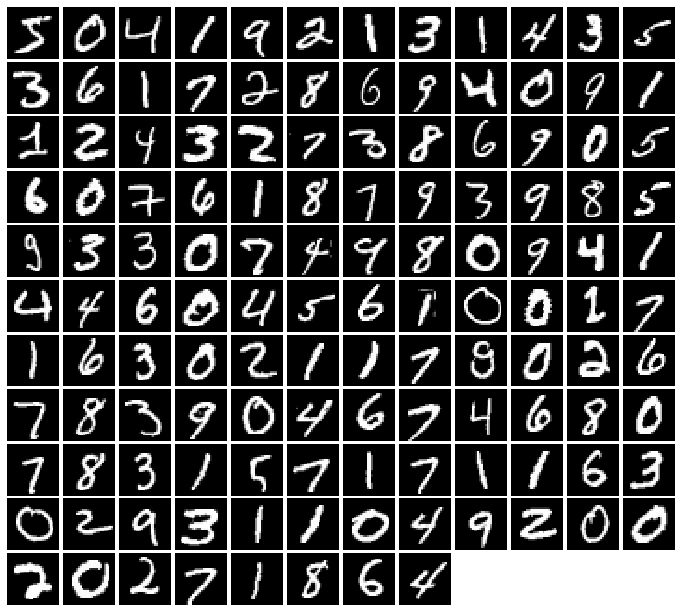

In [ ]:
batch_size = 128

mnist = datasets.MNIST('./MNIST_data', train=True, download=True,
                           transform=transforms.ToTensor())
loader_train = DataLoader(mnist, batch_size=batch_size, drop_last=True)


imgs = loader_train.__iter__().next()[0].view(batch_size, 784).numpy().squeeze()
show_images(imgs)

### Section 1.1.4 Train your model [7 pts]

- Call Discriminator and Generator for training.
- Call optimizers for both discriminator and generator for training. (Use Adam with lr=1e-3, betas = (0.5, 0.999))
- Call train function to train. 
- Train for 10 epochs.

After training your GAN model, you should expect results that resemble the following if your loss function and training loop implementations are correct:

<img src="files/gan_samples/mnist_gan.jpg" width=300>
Refer mnist.jpg from gan_samples folder.

EPOCH:  1
Iter: 0, D: 1.317, G:0.7151


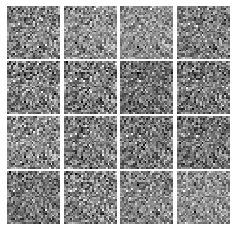


Iter: 250, D: 0.8667, G:1.532


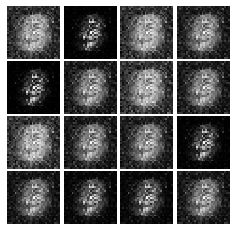


Saving the model as a checkpoint...
EPOCH:  2
Iter: 500, D: 0.7976, G:1.232


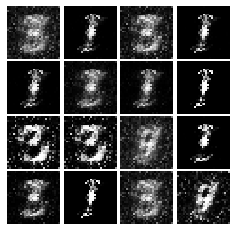


Iter: 750, D: 1.008, G:1.27


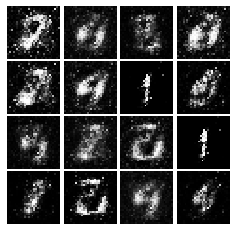


Saving the model as a checkpoint...
EPOCH:  3
Iter: 1000, D: 1.169, G:1.069


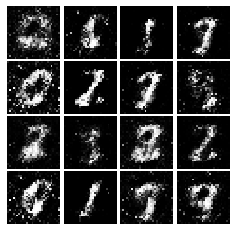


Iter: 1250, D: 1.211, G:1.186


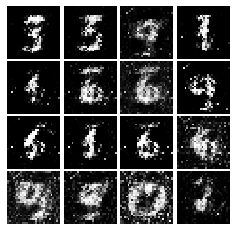


Saving the model as a checkpoint...
EPOCH:  4
Iter: 1500, D: 1.051, G:1.306


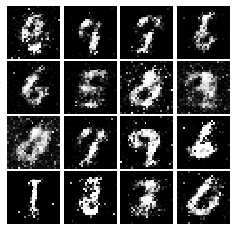


Iter: 1750, D: 1.07, G:1.11


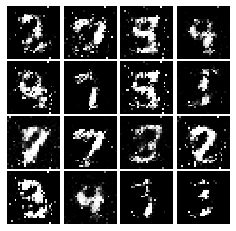


Saving the model as a checkpoint...
EPOCH:  5
Iter: 2000, D: 1.175, G:0.9065


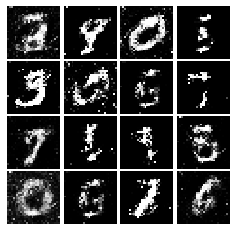


Iter: 2250, D: 1.402, G:1.593


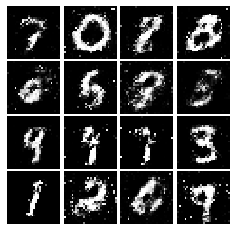


Saving the model as a checkpoint...
EPOCH:  6
Iter: 2500, D: 1.293, G:0.9386


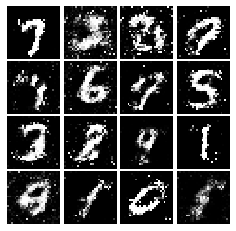


Iter: 2750, D: 1.281, G:0.9119


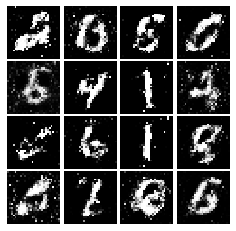


Saving the model as a checkpoint...
EPOCH:  7
Iter: 3000, D: 1.197, G:0.9624


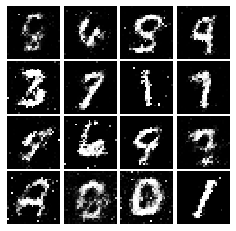


Iter: 3250, D: 1.2, G:0.9611


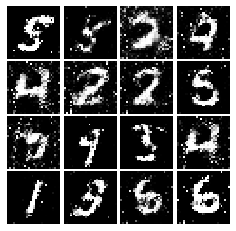


Saving the model as a checkpoint...
EPOCH:  8
Iter: 3500, D: 1.28, G:0.8495


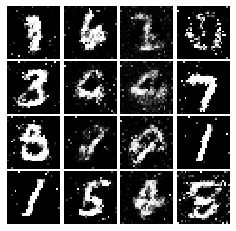


Saving the model as a checkpoint...
EPOCH:  9
Iter: 3750, D: 1.217, G:0.9314


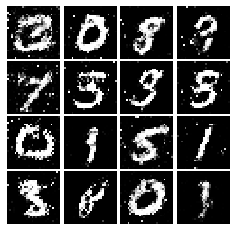


Iter: 4000, D: 1.32, G:0.8442


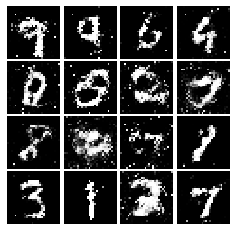


Saving the model as a checkpoint...
EPOCH:  10
Iter: 4250, D: 1.248, G:0.8771


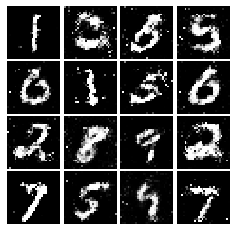


Iter: 4500, D: 1.295, G:0.9198


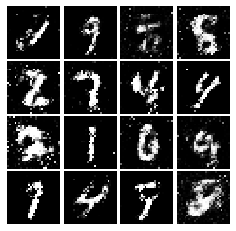


Saving the model as a checkpoint...


In [ ]:
# Add training code here:
netG = generator(NOISE_DIM).to(device)
netD = discriminator().to(device)
leraning_rate = 0.001

torch.autograd.set_detect_anomaly(True)

optimizerG = optim.Adam(netG.parameters(), lr=leraning_rate,
                            betas=(0.5, 0.999))
optimizerD = optim.Adam(netD.parameters(), lr=leraning_rate,
                            betas=(0.5, 0.999))

train(netD, netG, optimizerD, optimizerG, discriminator_loss, generator_loss, show_every=250, 
          ckpt_dir = path_to_homework + '/ckpts/Vanilla_gan_MINST/', cont_train=False,
          batch_size=128, noise_size=100, num_epochs=10, train_loader=loader_train, device=device)





## Section 1.2 Least-square GAN Loss
### Section 1.2.1 LSGAN Loss [10 pts]
We'll now look at [Least Squares GAN](https://arxiv.org/abs/1611.04076), a newer, more stable alernative to the original GAN loss function. For this part, all we have to do is change the loss function and retrain the model. We'll implement equation (9) in the paper, with the generator loss:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$
Fill in the `ls_discriminator_loss` and `ls_generator_loss` in the cell below.

**HINTS**: Instead of computing the expectation, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing. When plugging in for $D(x)$ and $D(G(z))$ use the direct output from the discriminator (`scores_real` and `scores_fake`).

In [8]:
def ls_discriminator_loss(logits_real, logits_fake):
    """
    Compute the Least-Squares GAN loss for the discriminator.

    Inputs:
    - scores_real: PyTorch Tensor of shape (N,) giving scores for the real data.
    - scores_fake: PyTorch Tensor of shape (N,) giving scores for the fake data.
 
    Outputs:
    - loss: A PyTorch Tensor containing the loss.
    """
 
    loss = None
    
    ####################################
    #          YOUR CODE HERE          #
    ####################################
    criterionGAN = torch.nn.functional.binary_cross_entropy_with_logits
    # real_label = 1.
    # fake_label = 0.
    # real_label = torch.full((logits_real.shape[0],1), real_label, dtype=torch.float, device=device)
    # fake_label = torch.full((logits_real.shape[0],1), fake_label, dtype=torch.float, device=device)
    real_label = torch.ones_like(logits_real)
    fake_label = torch.zeros_like(logits_fake)    
    D_real_loss = criterionGAN(logits_real, real_label)
    D_fake_loss = criterionGAN(logits_fake, fake_label)
    # print(D_real_loss)
    # print(D_fake_loss)
    loss = (D_real_loss-1)**2 + (D_fake_loss)**2

    ##########       END      ##########
    return loss

def ls_generator_loss(logits_fake):
    """
    Computes the Least-Squares GAN loss for the generator.
 
    Inputs:
    - scores_fake: PyTorch Tensor of shape (N,) giving scores for the fake data.
 
    Outputs:
    - loss: A PyTorch Tensor containing the loss.
    """

    loss = None
 
    ####################################
    #          YOUR CODE HERE          #
    ####################################
    criterionGAN = torch.nn.functional.binary_cross_entropy_with_logits
    # real_label = 1.

    # real_label = torch.full((logits_fake.shape[0],1), real_label, dtype=torch.float, device=device)
    real_label = torch.ones_like(logits_fake)    
    loss = criterionGAN(logits_fake, real_label)
    loss = (loss - 1) ** 2
    
    ##########       END      ##########
    return loss    

### Section 1.2.2 Train model with LSGAN loss[7 pts]

- Call Discriminator and Generator for training.
- Call optimizers for both discriminator and generator for training. (Use Adam with lr=1e-3, betas = (0.5, 0.999))
- Call train function to train. 
- Train for 10 epochs.

Similarly, train your LSGAN on MNIST dataset. You should expect results that resemble the following if your loss function and training loop implementations are correct:

<img src="files/gan_samples/mnist_ls.jpg" width=300>

EPOCH:  1
Iter: 0, D: 0.554, G:0.07988


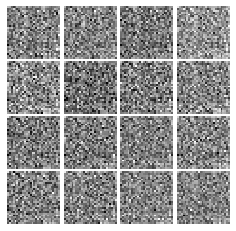


Iter: 250, D: 0.2373, G:0.009873


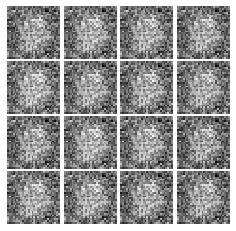


Saving the model as a checkpoint...
EPOCH:  2
Iter: 500, D: 0.1006, G:0.2025


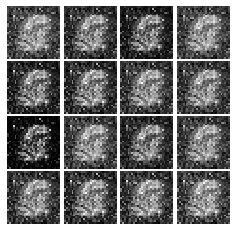


Iter: 750, D: 0.2914, G:0.502


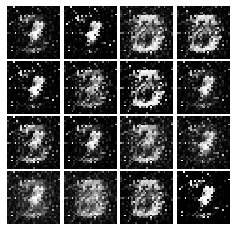


Saving the model as a checkpoint...
EPOCH:  3
Iter: 1000, D: 0.107, G:0.2152


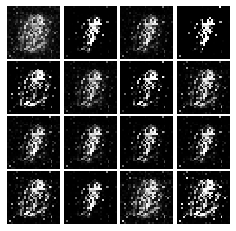


Iter: 1250, D: 0.1624, G:0.11


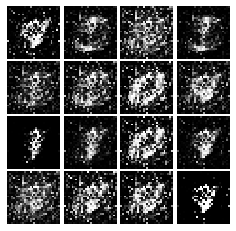


Saving the model as a checkpoint...
EPOCH:  4
Iter: 1500, D: 0.1392, G:0.0992


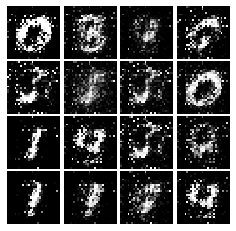


Iter: 1750, D: 0.163, G:0.0665


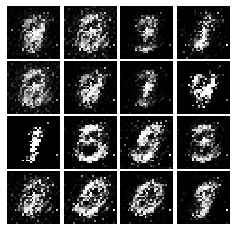


Saving the model as a checkpoint...
EPOCH:  5
Iter: 2000, D: 0.1455, G:0.08053


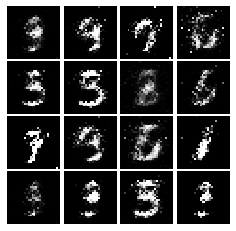


Iter: 2250, D: 0.1548, G:0.09198


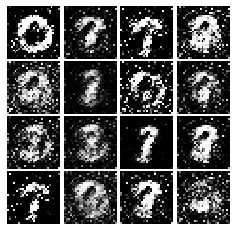


Saving the model as a checkpoint...
EPOCH:  6
Iter: 2500, D: 0.132, G:0.08403


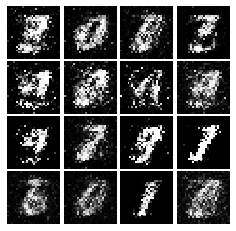


Iter: 2750, D: 0.1333, G:0.07101


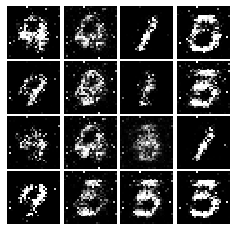


Saving the model as a checkpoint...
EPOCH:  7
Iter: 3000, D: 0.1993, G:0.04964


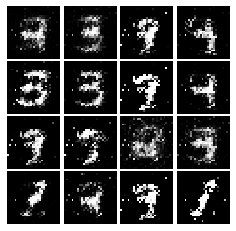


Iter: 3250, D: 0.1419, G:0.04155


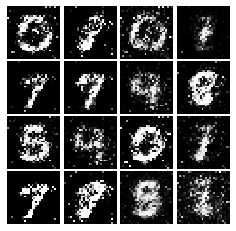


Saving the model as a checkpoint...
EPOCH:  8
Iter: 3500, D: 0.1488, G:0.09198


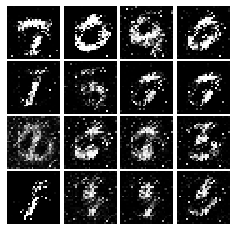


Saving the model as a checkpoint...
EPOCH:  9
Iter: 3750, D: 0.1547, G:0.4052


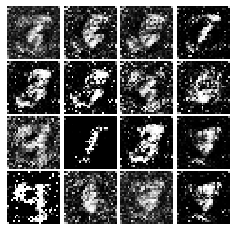


Iter: 4000, D: 0.1265, G:0.103


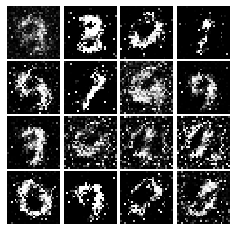


Saving the model as a checkpoint...
EPOCH:  10
Iter: 4250, D: 0.1426, G:0.0739


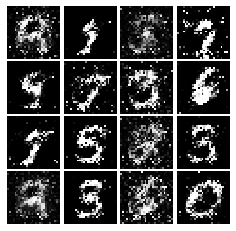


Iter: 4500, D: 0.1529, G:0.05996


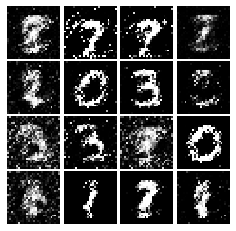


Saving the model as a checkpoint...


In [ ]:
# YOUR TRAINING CODE HERE
# Add training code here:
netG = generator(NOISE_DIM).to(device)
netD = discriminator().to(device)
leraning_rate = 0.001

torch.autograd.set_detect_anomaly(True)

optimizerG = optim.Adam(netG.parameters(), lr=leraning_rate,
                            betas=(0.5, 0.999))
optimizerD = optim.Adam(netD.parameters(), lr=leraning_rate,
                            betas=(0.5, 0.999))

train(netD, netG, optimizerD, optimizerG, ls_discriminator_loss, ls_generator_loss, show_every=250, 
          ckpt_dir = path_to_homework + '/ckpts/Vanilla_gan_MINST/', cont_train=False,
          batch_size=128, noise_size=100, num_epochs=10, train_loader=loader_train, device=device)

# Section 2. Generative Adversarial Networks on CelebA Dataset [56 pts]

In this section, you will need to:
1. Implement DCGAN architecture
2. Train it on CelebA dataset.

We are done with the simple, not-so-challenging MNIST dataset. Now, you need to implement a specific model architecture called [DCGAN](https://arxiv.org/pdf/1511.06434.pdf), and train your model to generate human faces!

### Section 2.1. GAN model architecture [20 pts]

Implement your generator and discriminator for generating faces. We recommend the following architectures which are inspired by [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):
**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Instead of Relu we use LeakyReLu throughout the discriminator (we use a negative slope value of 0.2). 

The output of your discriminator should be a single value score corresponding to each input sample. See `torch.nn.LeakyReLU`.


**Generator:**

**Note:** In the generator, you will need to use transposed convolution (sometimes known as fractionally-strided convolution or deconvolution). This function is implemented in pytorch as `torch.nn.ConvTranspose2d`.

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2

The output of the final layer of the generator network should have a `tanh` nonlinearity to output values between -1 and 1. The output should be a 3x64x64 tensor for each sample (equal dimensions to the images from the dataset).





In [9]:
# YOUR GENERATOR/DISCRIMINATOR HERE
# def discriminator():
class discriminator(nn.Module):
  def __init__(self):
    super(discriminator, self).__init__()
    """
    Initialize and return a simple discriminator model.
    """
    # Your code here:
    self.model = nn.Sequential(
      nn.Conv2d(in_channels=3,out_channels=128,kernel_size=4,stride=2, padding=(1, 1)),
      nn.LeakyReLU(0.2),
      nn.Conv2d(in_channels=128,out_channels=256,kernel_size=4,stride=2, padding=(1, 1)),
      nn.LeakyReLU(0.2),
      nn.BatchNorm2d(256),
      nn.Conv2d(in_channels=256,out_channels=512,kernel_size=4,stride=2, padding=(1, 1)),
      nn.LeakyReLU(0.2),
      nn.BatchNorm2d(512),
      nn.Conv2d(in_channels=512,out_channels=1024,kernel_size=4,stride=2, padding=(1, 1)),
      nn.LeakyReLU(0.2),
      nn.BatchNorm2d(1024),
      nn.Conv2d(in_channels=1024,out_channels=1,kernel_size=4,stride=1),
      nn.LeakyReLU(0.2)
        # nn.Sigmoid()
    )

  def forward(self,x):
    # x = x.view(x.shape[0], -1)
    result = self.model(x)

    return result

class generator(nn.Module):
  def __init__(self, noise_dim):
    super(generator, self).__init__()
    """
    Initialize and return a simple discriminator model.
    """
    # Your code here:
    # self.model = nn.Sequential(
    #     nn.Linear(noise_dim, 1024),
    #     nn.ReLU(),
    #     nn.Linear(1024, 1024),
    #     nn.ReLU(),
    #     nn.Linear(1024, 784),
    #     nn.Tanh(),
    # )
    self.model = nn.Sequential(
      nn.ConvTranspose2d(in_channels=NOISE_DIM,out_channels=1024,kernel_size=4,stride=1),
      nn.ReLU(),
      nn.BatchNorm2d(1024),
      nn.ConvTranspose2d(in_channels=1024,out_channels=512,kernel_size=4,stride=2, padding=(1, 1)),
      nn.ReLU(),
      nn.BatchNorm2d(512),
      nn.ConvTranspose2d(in_channels=512,out_channels=256,kernel_size=4,stride=2, padding=(1, 1)),
      nn.ReLU(),
      nn.BatchNorm2d(256),
      nn.ConvTranspose2d(in_channels=256,out_channels=128,kernel_size=4,stride=2, padding=(1, 1)),
      nn.ReLU(),
      nn.BatchNorm2d(128),
      nn.ConvTranspose2d(in_channels=128,out_channels=3,kernel_size=4,stride=2, padding=(1, 1)),
      nn.Tanh()
    )


  def forward(self,x):
    # print('start G')
    x = self.model(x)

    # result = self.model(x)

    return x


### Section 2.2 Data loading: Celeb A Dataset

The CelebA images we provide have been filtered to obtain only images with clear faces and have been cropped and downsampled to 128x128 resolution.

Run download_celeba.sh to get dataset.

In [12]:
! wget https://uofi.box.com/shared/static/q4pf89jtkvjndi4f8ip7wofuulhhphjj.zip

--2020-11-22 16:42:34--  https://uofi.box.com/shared/static/q4pf89jtkvjndi4f8ip7wofuulhhphjj.zip
Resolving uofi.box.com (uofi.box.com)... 185.235.236.197
Connecting to uofi.box.com (uofi.box.com)|185.235.236.197|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /public/static/q4pf89jtkvjndi4f8ip7wofuulhhphjj.zip [following]
--2020-11-22 16:42:35--  https://uofi.box.com/public/static/q4pf89jtkvjndi4f8ip7wofuulhhphjj.zip
Reusing existing connection to uofi.box.com:443.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://uofi.app.box.com/public/static/q4pf89jtkvjndi4f8ip7wofuulhhphjj.zip [following]
--2020-11-22 16:42:35--  https://uofi.app.box.com/public/static/q4pf89jtkvjndi4f8ip7wofuulhhphjj.zip
Resolving uofi.app.box.com (uofi.app.box.com)... 185.235.236.201
Connecting to uofi.app.box.com (uofi.app.box.com)|185.235.236.201|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://public.b

In [13]:
! mkdir celeba_data
# ! mv q4pf89jtkvjndi4f8ip7wofuulhhphjj.zip.1 q4pf89jtkvjndi4f8ip7wofuulhhphjj.zip
! unzip q4pf89jtkvjndi4f8ip7wofuulhhphjj.zip -d celeba_data
! rm q4pf89jtkvjndi4f8ip7wofuulhhphjj.zip

Streaming output truncated to the last 5000 lines.
  inflating: celeba_data/celeba_train_128res/175430_crop.jpg  
  inflating: celeba_data/celeba_train_128res/157564_crop.jpg  
  inflating: celeba_data/celeba_train_128res/039881_crop.jpg  
  inflating: celeba_data/celeba_train_128res/150303_crop.jpg  
  inflating: celeba_data/celeba_train_128res/145071_crop.jpg  
  inflating: celeba_data/celeba_train_128res/165362_crop.jpg  
  inflating: celeba_data/celeba_train_128res/197644_crop.jpg  
  inflating: celeba_data/celeba_train_128res/015423_crop.jpg  
  inflating: celeba_data/celeba_train_128res/188193_crop.jpg  
  inflating: celeba_data/celeba_train_128res/124213_crop.jpg  
  inflating: celeba_data/celeba_train_128res/160818_crop.jpg  
  inflating: celeba_data/celeba_train_128res/169663_crop.jpg  
  inflating: celeba_data/celeba_train_128res/066406_crop.jpg  
  inflating: celeba_data/celeba_train_128res/135163_crop.jpg  
  inflating: celeba_data/celeba_train_128res/116258_crop.jpg  
  in

In [14]:
batch_size = 128
scale_size = 64  # We resize the images to 64x64 for training

celeba_root = 'celeba_data'

In [15]:
celeba_train = ImageFolder(root=celeba_root, transform=transforms.Compose([
  transforms.Resize(scale_size),
  transforms.ToTensor(),
]))

# You can change the num_workers to speed up loading
celeba_loader_train = DataLoader(celeba_train, batch_size=batch_size, drop_last=True)

#### Visualize dataset

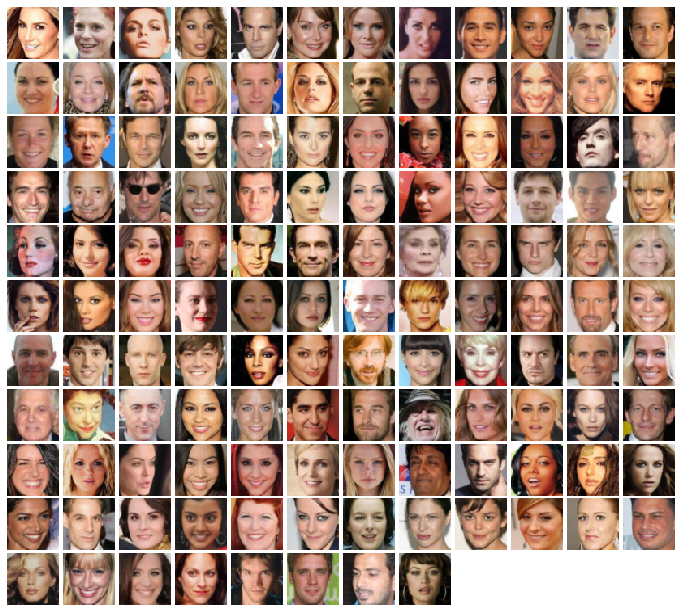

In [ ]:
imgs = celeba_loader_train.__iter__().next()[0].numpy().squeeze()
show_images(imgs, color=True)

### Section 2.3 Train a Vanilla GAN on CelebA [13 pts]

- Call discriminator and generator for training.
- Call optimizers for both discriminator and generator for training. (Use Adam with betas = (0.5, 0.999))
- Call train function to train. 
- Train for 30 epochs.

Now, train your GAN model with vanilla GAN loss. If you models are implemented correctly, you should see something like this:
<img src="files/gan_samples/celeba.jpg" width=300>


Now, train your model. **Observe the visualized result of your model, and describe what you see.**

In [21]:
NOISE_DIM = 100
NUM_EPOCHS = 30
learning_rate = 0.0002

In [17]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
 
def train(D, G, D_solver, G_solver, discriminator_loss, generator_loss, show_every=250, 
          ckpt_dir = path_to_homework + '/ckpts/Vanilla_gan_MINST/', cont_train=False,
          batch_size=128, noise_size=100, num_epochs=10, train_loader=None, device=None):
    """
    Train loop for GAN.

    The loop will consist of two steps: a discriminator step and a generator step.

    (1) In the discriminator step, you should zero gradients in the discriminator
    and sample noise to generate a fake data batch using the generator. Flatten real images 
    to 784 (28 * 28). Calculate the discriminator output for real and fake data, 
    and use the output to compute discriminator loss. Call backward() on the loss 
    output and take an optimizer step for the discriminator.

    (2) For the generator step, you should once again zero gradients in the generator
    and sample noise to generate a fake data batch. Get the discriminator output
    for the fake data batch and use this to compute the generator loss. Once again
    call backward() on the loss and take an optimizer step.

    You will need to reshape the fake image tensor outputted by the generator to
    be dimensions (batch_size x input_channels x img_size x img_size).

    Use the sample_noise function to sample random noise, and the discriminator_loss
    and generator_loss functions for their respective loss computations

    Inputs:
    - D, G: PyTorch models for the discriminator and generator
    - D_solver, G_solver: torch.optim Optimizers to use for training the
      discriminator and generator.
    - discriminator_loss, generator_loss: Functions to use for computing the generator and
      discriminator loss, respectively.
    - show_every: Show samples after every show_every iterations.
    - batch_size: Batch size to use for training.
    - noise_size: Dimension of the noise to use as input to the generator.
    - num_epochs: Number of epochs over the training dataset to use for training.
    - train_loader: image dataloader
    - device: PyTorch device
    """
    if os.path.exists(os.path.join(ckpt_dir, 'checkpoint.pth')) and cont_train:
        ckpt = torch.load(os.path.join(ckpt_dir, 'checkpoint.pth'))
        start_epoch = ckpt['epoch'] + 1
        iter_count = ckpt['iter_count'] + 1
        G.load_state_dict(ckpt['G'])
        D.load_state_dict(ckpt['D'])
        print('Start from a checkpoint: {}, epoch:{}, iter:{}'.format(os.path.join(ckpt_dir, 'checkpoint.pth'), 
                                                 str(start_epoch), str(iter_count)))
    else:
        start_epoch = 0
        iter_count = 0
      
    # G.to(device)
    # D.to(device)
        
    for epoch in range(start_epoch, num_epochs):
        print('EPOCH: ', (epoch+1))
        for x, _ in train_loader:
            # print(x.shape)
            batch_num, input_channels, img_size, _ = x.shape

            real_images = preprocess_img(x).to(device)  # normalize

            # Store discriminator loss output, generator loss output, and fake image output
            # in these variables for logging and visualization below
            d_error = None
            g_error = None
            fake_images = None


            ####################################
            #        Generator step        #
            #          YOUR CODE HERE          #
            ####################################
            # print(batch_num)
            # noise = (torch.random.normal(0, 1, (batch_num, NOISE_DIM)))

            # noise = torch.rand(batch_num, NOISE_DIM).to(device)
            noise = torch.randn(batch_num, NOISE_DIM, 1, 1).to(device)
            noise = noise/torch.max(noise)

            # print(noise.shape)
            # print(G)
            
            
            
            fake_images = G(noise)
            fake_images = fake_images.to(device)

            
            #########       END      ###########
 
            ####################################
            #          Discriminator step          #
            #          YOUR CODE HERE          #
            ####################################
            D.zero_grad()
            # print(fake_images.shape)
            # print(real_images.shape)
            fake_lo_D = D(fake_images.detach())
            # print('finish D')
            real_lo_D = D(real_images)
            # print(fake_lo)
            # print(real_lo)
            d_error = discriminator_loss(real_lo_D, fake_lo_D)
            d_error.backward()
            D_solver.step()

            G.zero_grad()
            fake_lo_G = D(fake_images)
            g_error = generator_loss(fake_lo_G)
            g_error.backward()
            G_solver.step()




            
            ##########       END      ##########
            if (iter_count % show_every == 0):
                print('Iter: {}, D: {:.4}, G:{:.4}'.format(iter_count,d_error.item(),g_error.item()))
                disp_fake_images = deprocess_img(fake_images.data)  # denormalize
                imgs_numpy = (disp_fake_images).cpu().numpy()
                show_images(imgs_numpy[0:16], color=input_channels!=1)
                plt.show()
                print()
            iter_count += 1
            
        # save checkpoints
        os.makedirs(ckpt_dir, exist_ok=True)
        print('Saving the model as a checkpoint...')
        torch.save({'epoch': epoch, 
                    'iter_count': iter_count,
                    'G': G.state_dict(), 
                    'D': D.state_dict()}, 
                   os.path.join(ckpt_dir, 'checkpoint.pth'))

EPOCH:  1
Iter: 0, D: 1.344, G:3.31


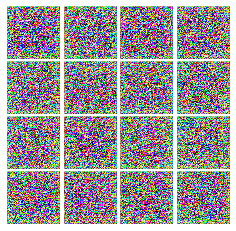


Iter: 250, D: 1.312, G:1.392


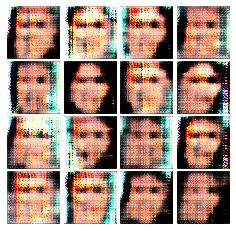


Iter: 500, D: 2.207, G:1.877


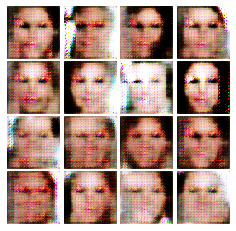


Iter: 750, D: 1.267, G:1.385


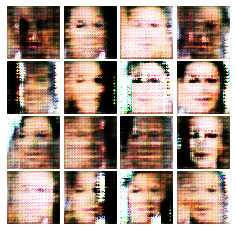


Saving the model as a checkpoint...
EPOCH:  2
Iter: 1000, D: 1.786, G:1.624


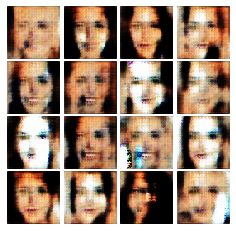


Iter: 1250, D: 1.486, G:1.003


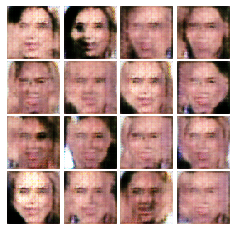


Iter: 1500, D: 1.389, G:0.9968


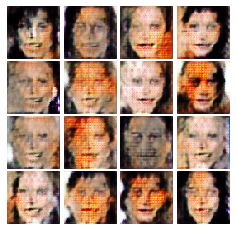


Iter: 1750, D: 1.306, G:1.102


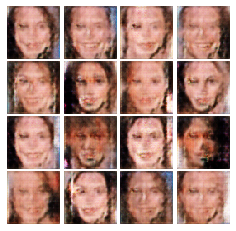


Saving the model as a checkpoint...
EPOCH:  3
Iter: 2000, D: 1.336, G:1.178


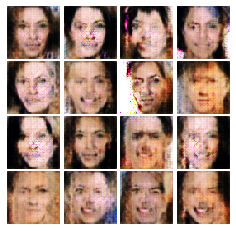


Iter: 2250, D: 1.394, G:1.573


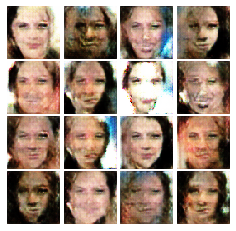


Iter: 2500, D: 1.222, G:0.9941


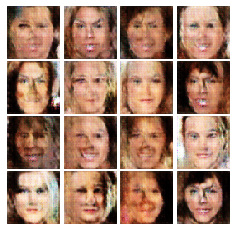


Iter: 2750, D: 1.169, G:0.842


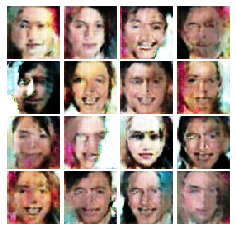


Saving the model as a checkpoint...
EPOCH:  4
Iter: 3000, D: 1.463, G:1.011


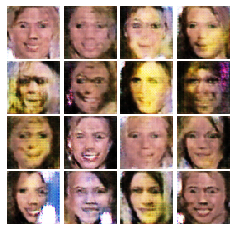


Iter: 3250, D: 1.462, G:1.016


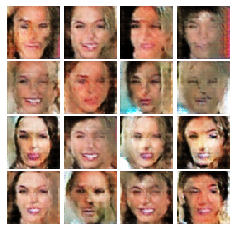


Iter: 3500, D: 1.197, G:0.8427


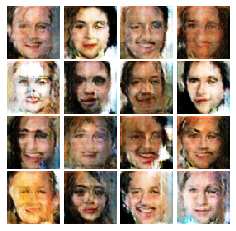


Iter: 3750, D: 1.277, G:1.179


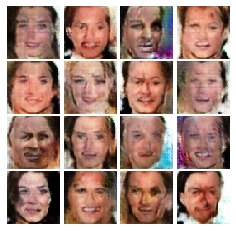


Saving the model as a checkpoint...
EPOCH:  5
Iter: 4000, D: 1.222, G:1.04


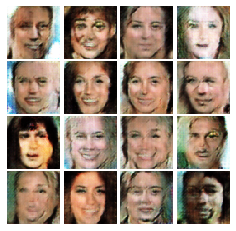


Iter: 4250, D: 1.25, G:0.8133


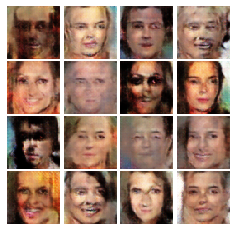


Iter: 4500, D: 1.407, G:1.025


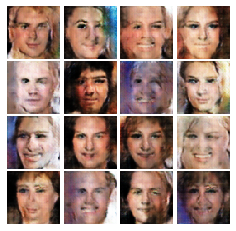


Iter: 4750, D: 1.348, G:0.9302


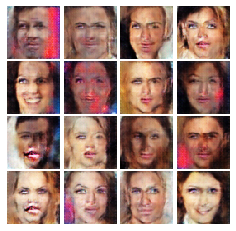


Saving the model as a checkpoint...
EPOCH:  6
Iter: 5000, D: 1.195, G:0.8113


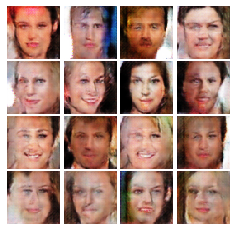


Iter: 5250, D: 1.4, G:0.8686


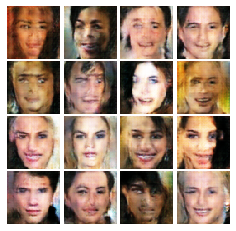


Iter: 5500, D: 1.296, G:0.78


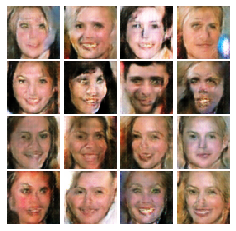


Iter: 5750, D: 1.428, G:0.8338


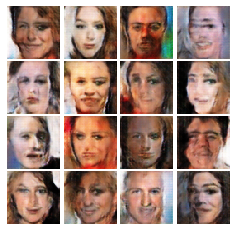


Saving the model as a checkpoint...
EPOCH:  7
Iter: 6000, D: 1.409, G:0.7745


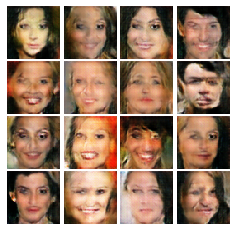


Iter: 6250, D: 1.338, G:0.7514


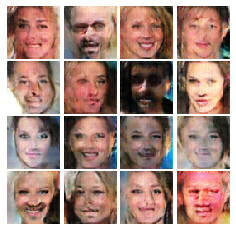


Iter: 6500, D: 1.282, G:0.7588


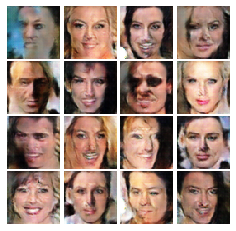


Iter: 6750, D: 1.325, G:0.7498


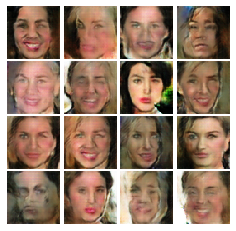


Saving the model as a checkpoint...
EPOCH:  8
Iter: 7000, D: 1.341, G:0.8338


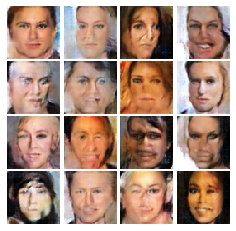


Iter: 7250, D: 1.45, G:0.8092


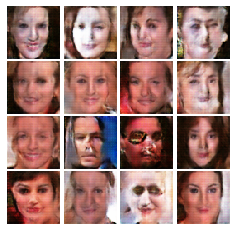


Iter: 7500, D: 1.332, G:0.7597


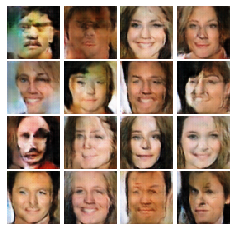


Iter: 7750, D: 1.381, G:0.7625


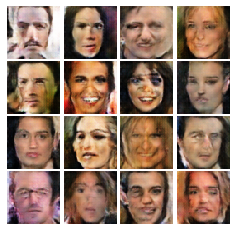


Saving the model as a checkpoint...
EPOCH:  9
Iter: 8000, D: 1.256, G:0.7502


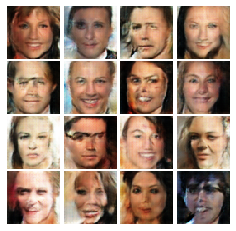


Iter: 8250, D: 1.376, G:0.8935


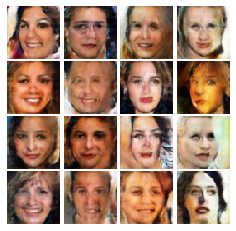


Iter: 8500, D: 1.19, G:0.7999


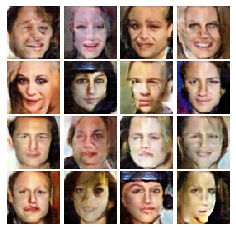


Iter: 8750, D: 1.388, G:0.7939


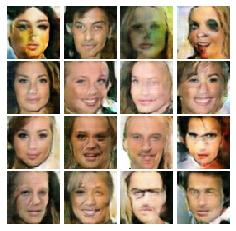


Saving the model as a checkpoint...
EPOCH:  10
Iter: 9000, D: 1.439, G:0.7845


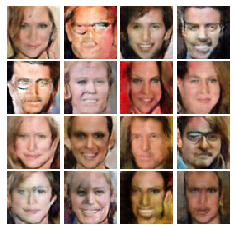


Iter: 9250, D: 1.423, G:0.8332


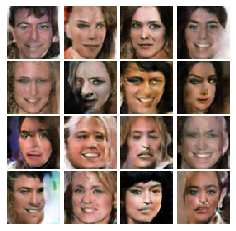


Iter: 9500, D: 1.395, G:0.8163


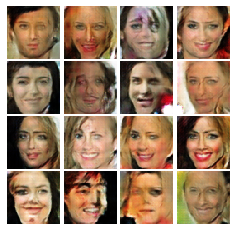


Iter: 9750, D: 1.398, G:1.003


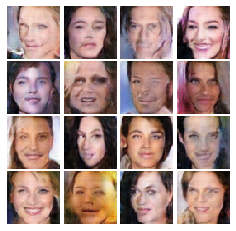


Saving the model as a checkpoint...
EPOCH:  11
Iter: 10000, D: 1.248, G:0.9312


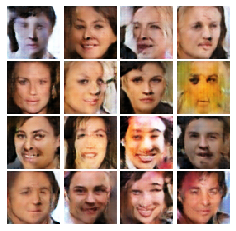


Iter: 10250, D: 1.389, G:0.8085


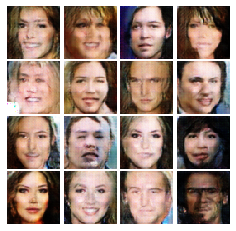


Iter: 10500, D: 1.372, G:0.7795


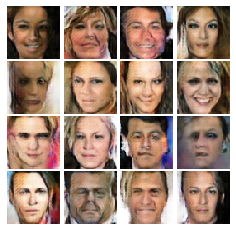


Iter: 10750, D: 1.297, G:0.7921


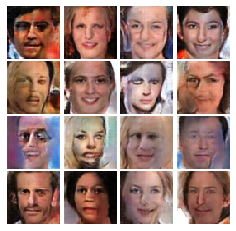


Saving the model as a checkpoint...
EPOCH:  12
Iter: 11000, D: 1.39, G:0.8193


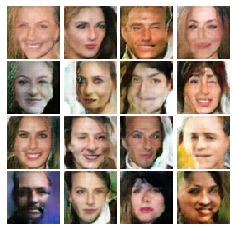


Iter: 11250, D: 1.394, G:0.8239


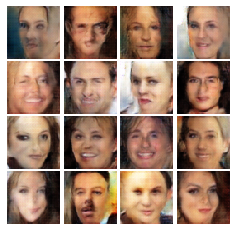


Iter: 11500, D: 1.366, G:0.9665


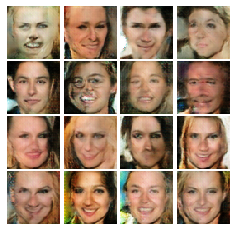


Iter: 11750, D: 1.34, G:0.8925


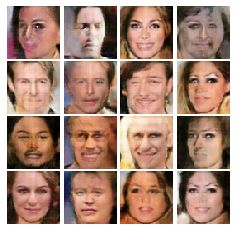


Saving the model as a checkpoint...
EPOCH:  13
Iter: 12000, D: 1.253, G:0.6876


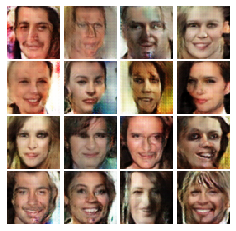


Iter: 12250, D: 1.426, G:0.77


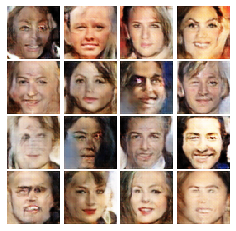


Iter: 12500, D: 1.398, G:0.7576


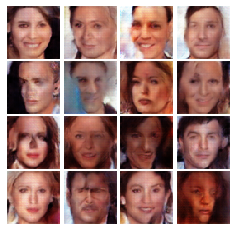


Iter: 12750, D: 1.369, G:0.841


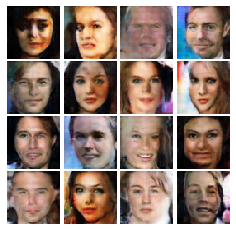


Saving the model as a checkpoint...
EPOCH:  14
Iter: 13000, D: 1.348, G:0.8895


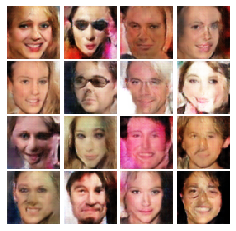


Iter: 13250, D: 1.318, G:0.7963


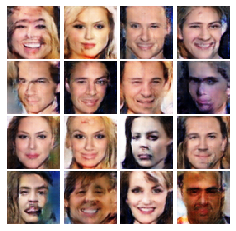


Iter: 13500, D: 1.262, G:0.7987


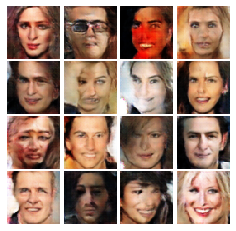


Iter: 13750, D: 1.335, G:0.8642


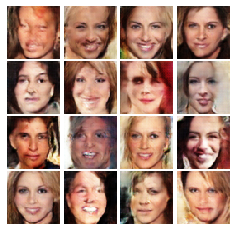


Saving the model as a checkpoint...
EPOCH:  15
Iter: 14000, D: 1.399, G:0.9225


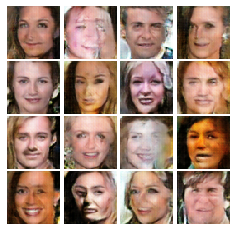


Iter: 14250, D: 1.331, G:0.8092


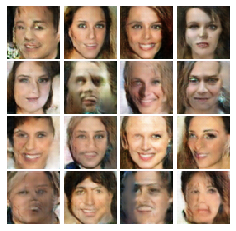


Iter: 14500, D: 1.472, G:0.8614


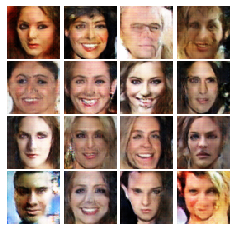


Iter: 14750, D: 1.397, G:0.8415


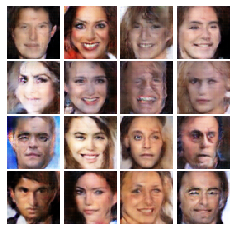


Saving the model as a checkpoint...
EPOCH:  16
Iter: 15000, D: 1.422, G:0.821


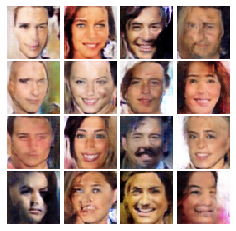


Iter: 15250, D: 1.419, G:0.93


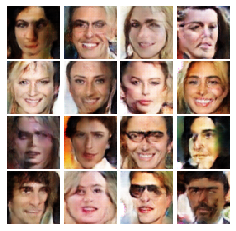


Iter: 15500, D: 1.463, G:0.9881


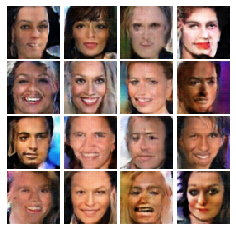


Iter: 15750, D: 1.308, G:0.6971


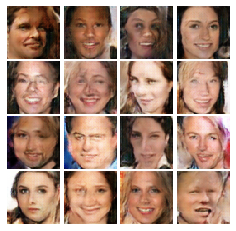


Saving the model as a checkpoint...
EPOCH:  17
Iter: 16000, D: 1.368, G:0.781


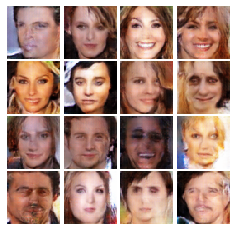


Iter: 16250, D: 1.411, G:0.8766


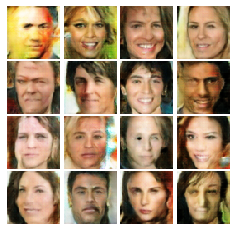


Iter: 16500, D: 1.391, G:0.9188


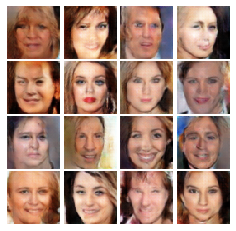


Iter: 16750, D: 1.144, G:0.7549


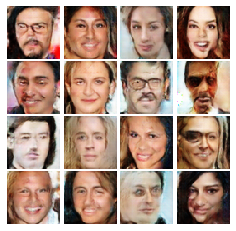


Saving the model as a checkpoint...
EPOCH:  18
Iter: 17000, D: 1.27, G:0.7786


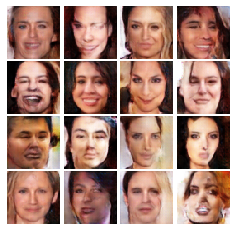


Iter: 17250, D: 1.36, G:0.8479


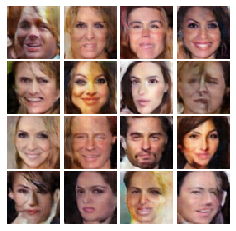


Iter: 17500, D: 1.358, G:0.8207


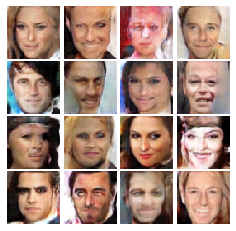


Saving the model as a checkpoint...
EPOCH:  19
Iter: 17750, D: 1.437, G:0.9488


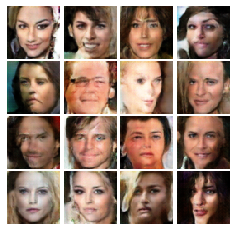


Iter: 18000, D: 1.42, G:0.8588


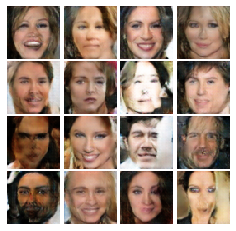


Iter: 18250, D: 1.392, G:0.8591


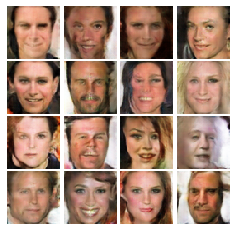


Iter: 18500, D: 1.305, G:0.9043


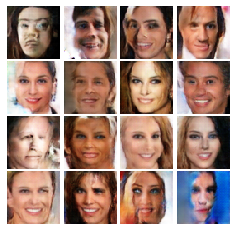


Saving the model as a checkpoint...
EPOCH:  20
Iter: 18750, D: 1.45, G:0.8098


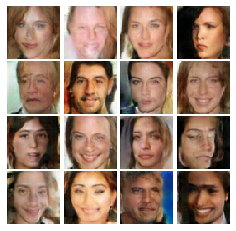


Iter: 19000, D: 0.9953, G:0.9233


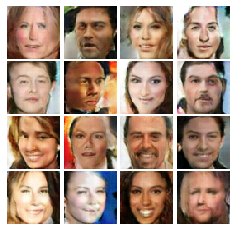


Iter: 19250, D: 1.33, G:0.8748


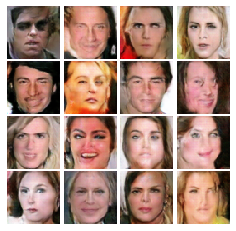


Iter: 19500, D: 1.151, G:0.8882


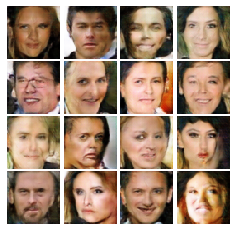


Saving the model as a checkpoint...
EPOCH:  21
Iter: 19750, D: 1.216, G:0.8903


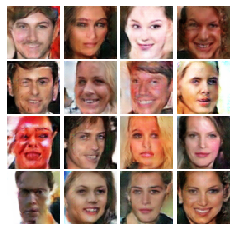


Iter: 20000, D: 1.378, G:0.8579


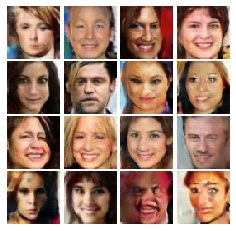


Iter: 20250, D: 1.428, G:0.837


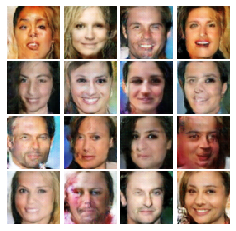


Iter: 20500, D: 1.386, G:0.8641


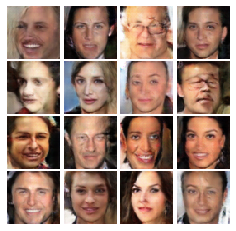


Saving the model as a checkpoint...
EPOCH:  22
Iter: 20750, D: 1.17, G:0.9803


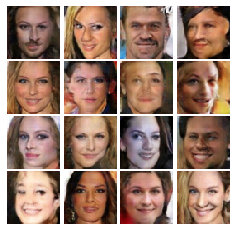


Iter: 21000, D: 1.214, G:0.9843


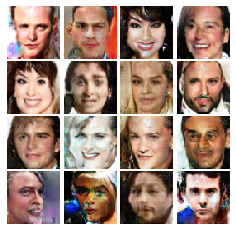


Iter: 21250, D: 1.365, G:1.17


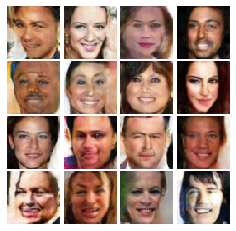


Iter: 21500, D: 1.298, G:1.251


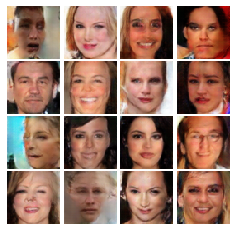


Saving the model as a checkpoint...
EPOCH:  23
Iter: 21750, D: 1.279, G:0.82


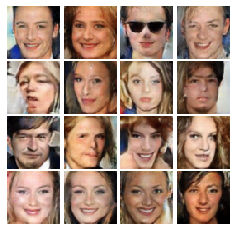


Iter: 22000, D: 1.316, G:0.8044


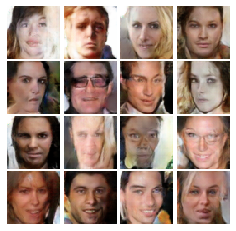


Iter: 22250, D: 1.077, G:1.421


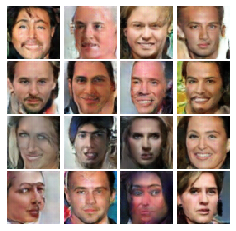


Iter: 22500, D: 1.155, G:1.075


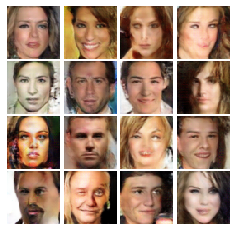


Saving the model as a checkpoint...
EPOCH:  24
Iter: 22750, D: 1.447, G:1.862


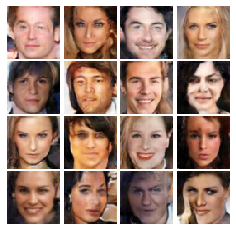


Iter: 23000, D: 1.12, G:0.997


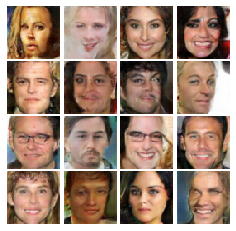


Iter: 23250, D: 0.9512, G:1.055


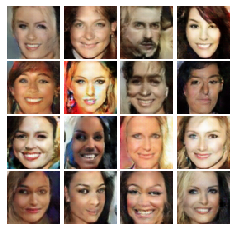


Iter: 23500, D: 0.9271, G:1.28


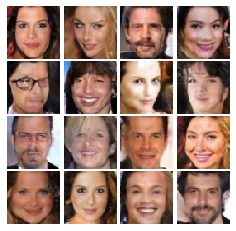


Saving the model as a checkpoint...
EPOCH:  25
Iter: 23750, D: 1.254, G:0.9406


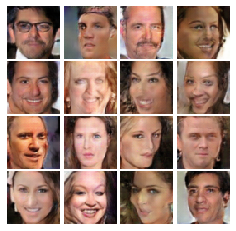


Iter: 24000, D: 0.9313, G:1.134


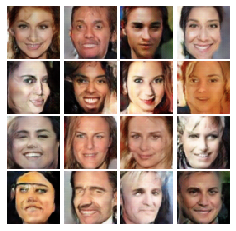


Iter: 24250, D: 1.451, G:1.83


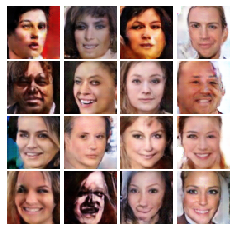


Iter: 24500, D: 1.217, G:1.575


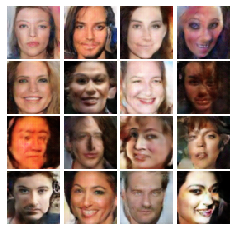


Saving the model as a checkpoint...
EPOCH:  26
Iter: 24750, D: 0.8719, G:0.9279


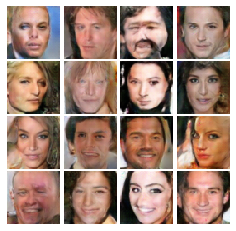


Iter: 25000, D: 1.432, G:1.556


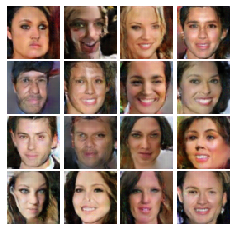


Iter: 25250, D: 0.9619, G:0.6214


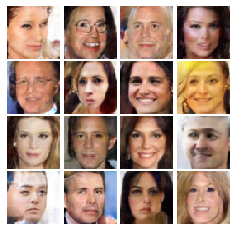


Iter: 25500, D: 0.7142, G:1.22


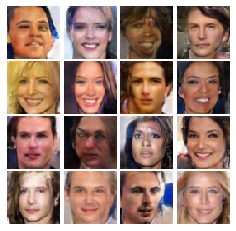


Saving the model as a checkpoint...
EPOCH:  27
Iter: 25750, D: 0.5668, G:1.176


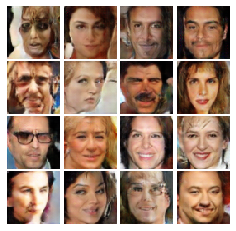


Iter: 26000, D: 1.464, G:1.437


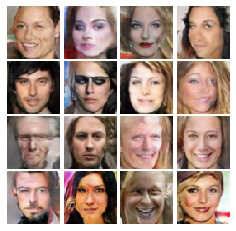


Iter: 26250, D: 0.8025, G:1.086


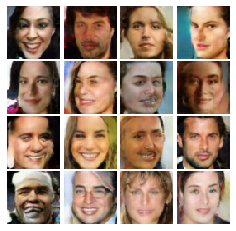


Iter: 26500, D: 0.8724, G:1.617


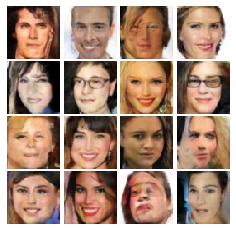


Saving the model as a checkpoint...
EPOCH:  28
Iter: 26750, D: 0.6698, G:1.085


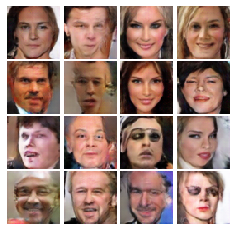


Iter: 27000, D: 1.158, G:0.7635


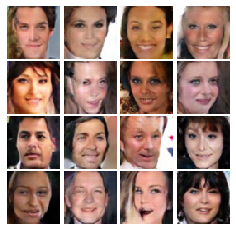


Iter: 27250, D: 1.328, G:1.566


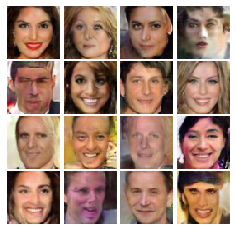


Iter: 27500, D: 2.506, G:3.779


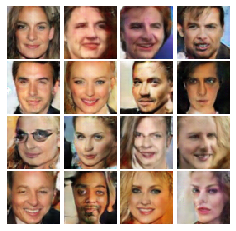


Saving the model as a checkpoint...
EPOCH:  29
Iter: 27750, D: 0.484, G:1.517


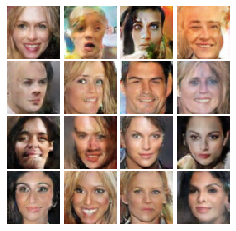


Iter: 28000, D: 1.982, G:4.309


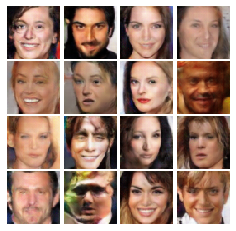


Iter: 28250, D: 0.6042, G:1.244


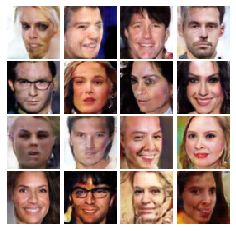


Iter: 28500, D: 0.7302, G:2.265


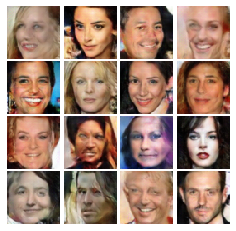


Saving the model as a checkpoint...
EPOCH:  30
Iter: 28750, D: 0.4431, G:1.502


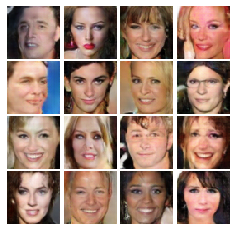


Iter: 29000, D: 0.3747, G:1.598


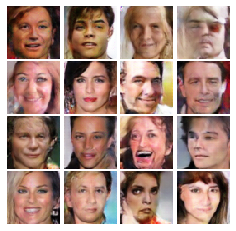


Iter: 29250, D: 0.6563, G:1.179


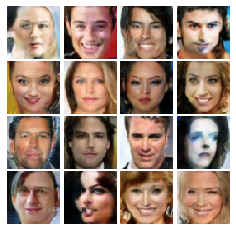


Iter: 29500, D: 0.798, G:0.7929


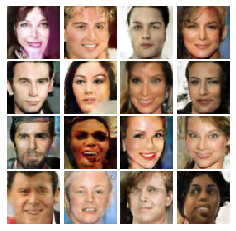


Saving the model as a checkpoint...


In [ ]:
# original GAN
# Add code here:
netG = generator(NOISE_DIM).to(device)
netD = discriminator().to(device)
leraning_rate = 0.001


torch.autograd.set_detect_anomaly(True)

optimizerG = optim.Adam(netG.parameters(), lr=leraning_rate,
                            betas=(0.5, 0.999))
optimizerD = optim.Adam(netD.parameters(), lr=leraning_rate,
                            betas=(0.5, 0.999))

train(netD, netG, optimizerD, optimizerG, discriminator_loss, generator_loss, show_every=250, 
          ckpt_dir = path_to_homework + '/ckpts/Vanilla_gan_MINST/', cont_train=False,
          batch_size=128, noise_size=100, num_epochs=NUM_EPOCHS, train_loader=celeba_loader_train, device=device)

### What I see
When the epochs increase, the generated images are better.

Besides, the images are diverse due to random noise.

### Section 2.4 Train a LSGAN on CelebA [13 pts]

- Call discriminator and generator for training.
- Call optimizers for both discriminator and generator for training. (Use Adam with betas = (0.5, 0.999))
- Call train function to train. 
- Train for 30 epochs.

Now, train your GAN model with LSGAN loss. **Observe the visualized result of your model, and describe what you see.**

EPOCH:  1
Iter: 0, D: 0.9284, G:13.15


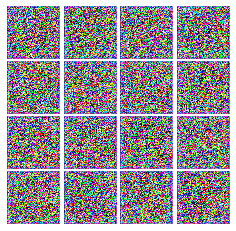


Iter: 250, D: 0.1741, G:0.04219


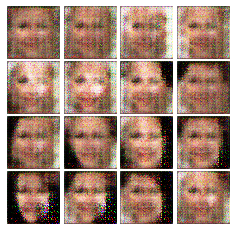


Iter: 500, D: 0.1714, G:0.05283


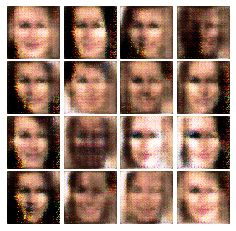


Iter: 750, D: 0.1694, G:0.08077


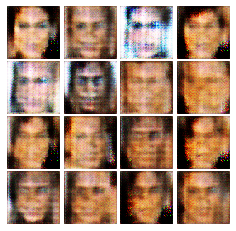


Saving the model as a checkpoint...
EPOCH:  2
Iter: 1000, D: 0.1647, G:0.05259


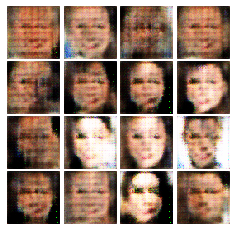


Iter: 1250, D: 0.1647, G:0.06913


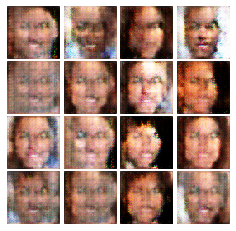


Iter: 1500, D: 0.1838, G:0.04693


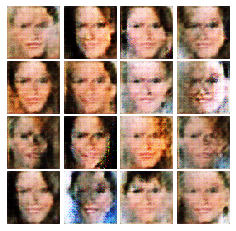


Iter: 1750, D: 0.1811, G:0.05412


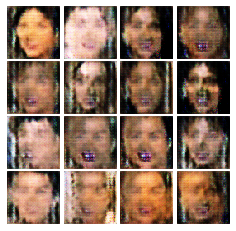


Saving the model as a checkpoint...
EPOCH:  3
Iter: 2000, D: 0.1814, G:0.05149


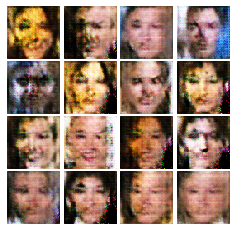


Iter: 2250, D: 0.1721, G:0.06601


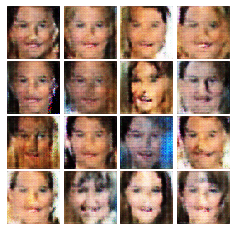


Iter: 2500, D: 0.1867, G:0.07131


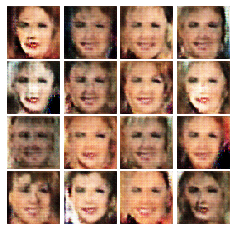


Iter: 2750, D: 0.165, G:0.0598


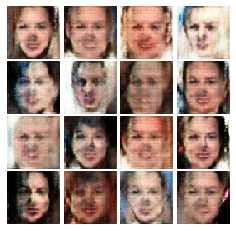


Saving the model as a checkpoint...
EPOCH:  4
Iter: 3000, D: 0.145, G:0.1218


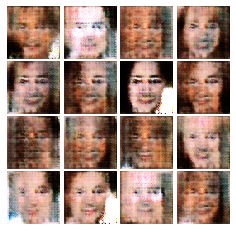


Iter: 3250, D: 0.32, G:0.0002842


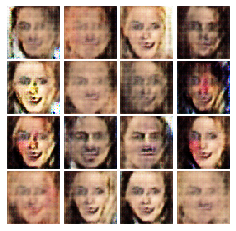


Iter: 3500, D: 10.92, G:13.38


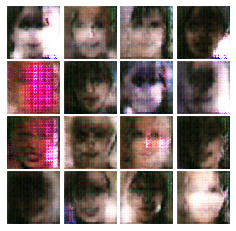


Iter: 3750, D: 0.2326, G:0.03986


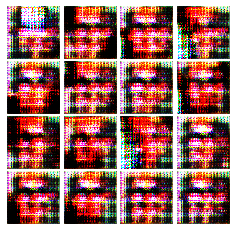


Saving the model as a checkpoint...
EPOCH:  5
Iter: 4000, D: 0.1565, G:0.07247


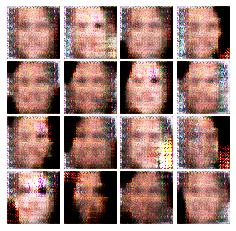


Iter: 4250, D: 0.1398, G:0.2094


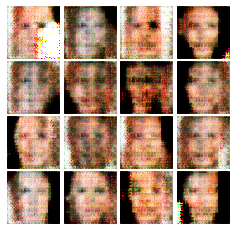


Iter: 4500, D: 0.1683, G:0.0381


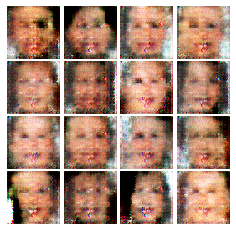


Iter: 4750, D: 0.1624, G:0.05472


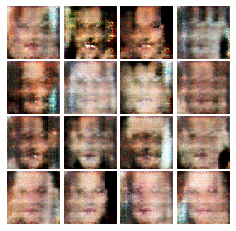


Saving the model as a checkpoint...
EPOCH:  6
Iter: 5000, D: 0.1605, G:0.08181


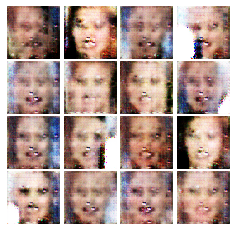


Iter: 5250, D: 0.17, G:0.07308


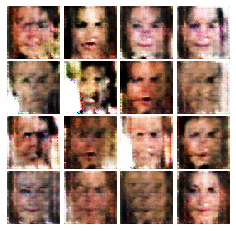


Iter: 5500, D: 0.1613, G:0.06415


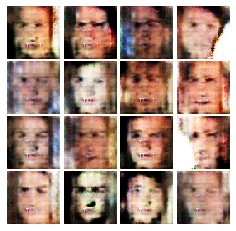


Iter: 5750, D: 0.1546, G:0.1146


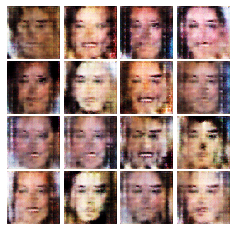


Saving the model as a checkpoint...
EPOCH:  7
Iter: 6000, D: 0.2495, G:0.001051


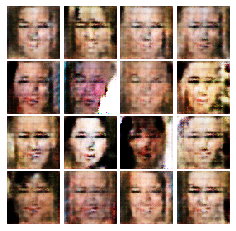


Iter: 6250, D: 0.1929, G:0.2056


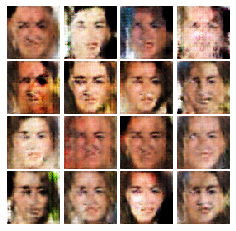


Iter: 6500, D: 0.1633, G:0.05465


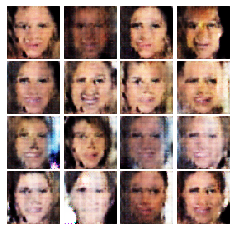


Iter: 6750, D: 0.1728, G:0.1004


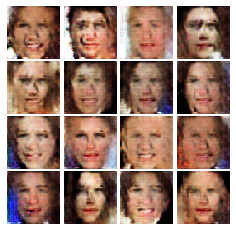


Saving the model as a checkpoint...
EPOCH:  8
Iter: 7000, D: 0.1569, G:0.1277


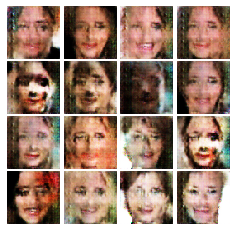


Iter: 7250, D: 0.1804, G:0.04538


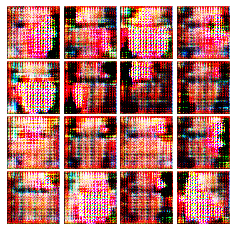


Iter: 7500, D: 0.2119, G:0.02221


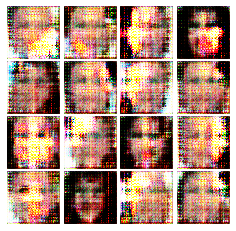


Iter: 7750, D: 0.08642, G:0.3794


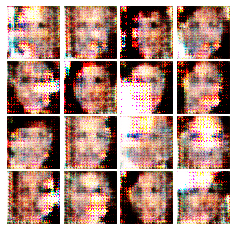


Saving the model as a checkpoint...
EPOCH:  9
Iter: 8000, D: 0.1933, G:0.01596


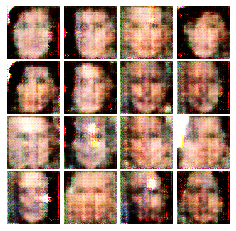


Iter: 8250, D: 0.1399, G:0.06666


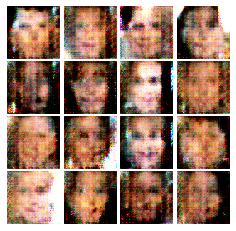


Iter: 8500, D: 0.1815, G:0.03936


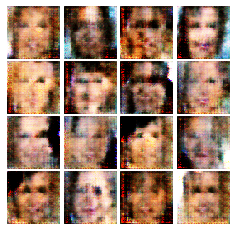


Iter: 8750, D: 0.1662, G:0.04108


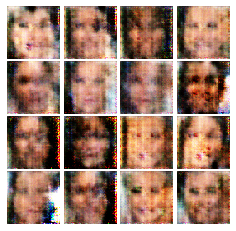


Saving the model as a checkpoint...
EPOCH:  10
Iter: 9000, D: 0.1706, G:0.03876


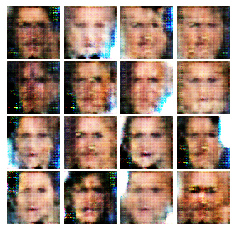


Iter: 9250, D: 0.1514, G:0.06543


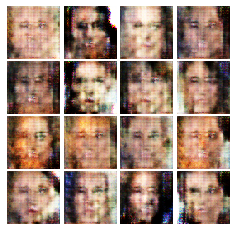


Iter: 9500, D: 0.1691, G:0.0689


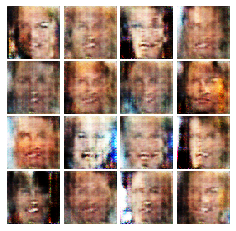


Iter: 9750, D: 0.1718, G:0.03307


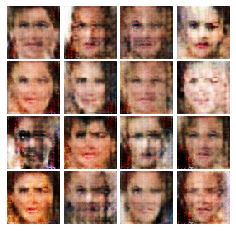


Saving the model as a checkpoint...
EPOCH:  11
Iter: 10000, D: 0.1689, G:0.04771


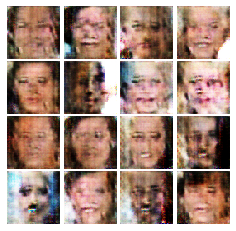


Iter: 10250, D: 0.1542, G:0.07737


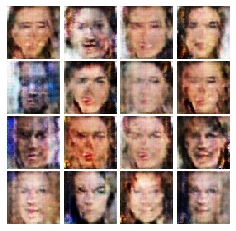


Iter: 10500, D: 1.855, G:1.605


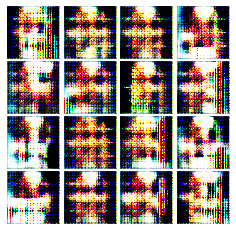


Iter: 10750, D: 0.1475, G:0.1608


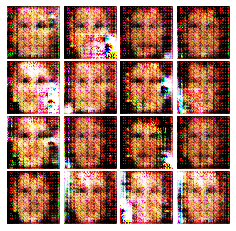


Saving the model as a checkpoint...
EPOCH:  12
Iter: 11000, D: 0.1511, G:0.1161


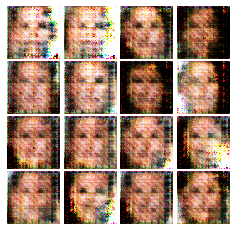


Iter: 11250, D: 0.1536, G:0.02821


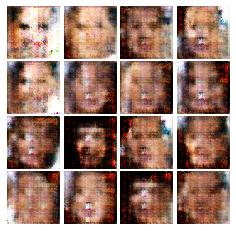


Iter: 11500, D: 0.1877, G:0.03185


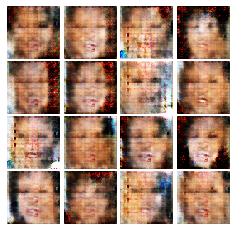


Iter: 11750, D: 0.1583, G:0.05824


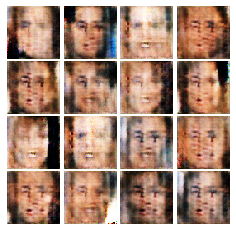


Saving the model as a checkpoint...
EPOCH:  13
Iter: 12000, D: 0.1554, G:0.09737


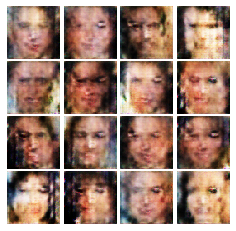


Iter: 12250, D: 0.1558, G:0.03973


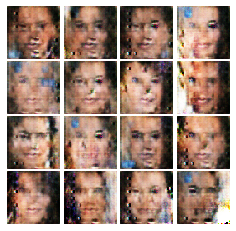


Iter: 12500, D: 0.1471, G:0.1035


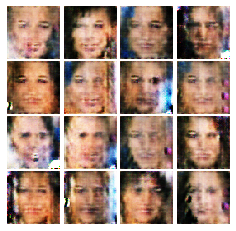


Iter: 12750, D: 0.1469, G:0.06528


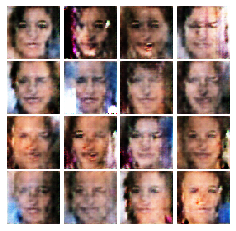


Saving the model as a checkpoint...
EPOCH:  14
Iter: 13000, D: 0.2307, G:0.002036


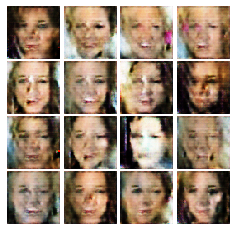


Iter: 13250, D: 0.1405, G:0.09732


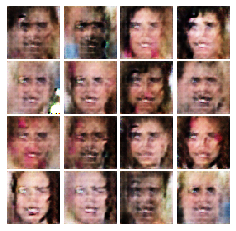


Iter: 13500, D: 0.1615, G:0.04056


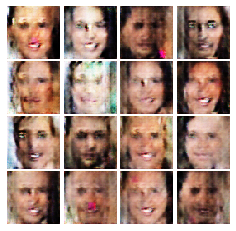


Iter: 13750, D: 1.215, G:0.3546


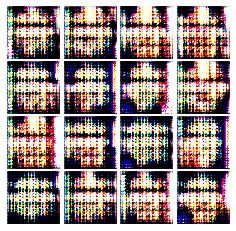


Saving the model as a checkpoint...
EPOCH:  15
Iter: 14000, D: 0.1833, G:0.4238


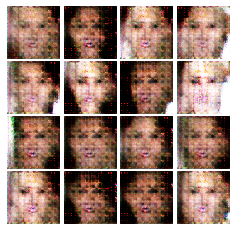


Iter: 14250, D: 0.1298, G:0.05354


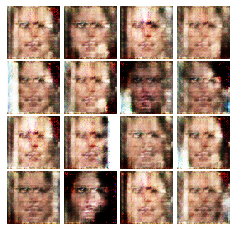


Iter: 14500, D: 0.1491, G:0.118


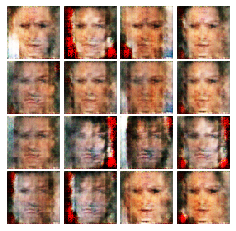


Iter: 14750, D: 0.1838, G:0.0279


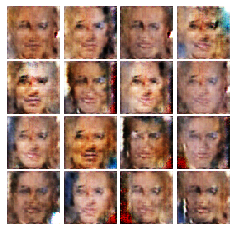


Saving the model as a checkpoint...
EPOCH:  16
Iter: 15000, D: 0.1515, G:0.3068


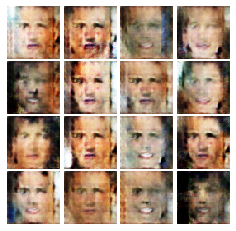


Iter: 15250, D: 0.1126, G:0.1516


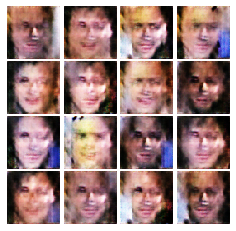


Iter: 15500, D: 0.6623, G:0.01795


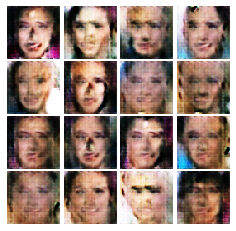


Iter: 15750, D: 0.1313, G:0.2205


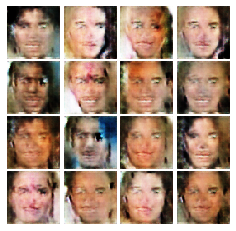


Saving the model as a checkpoint...
EPOCH:  17
Iter: 16000, D: 0.1202, G:0.1198


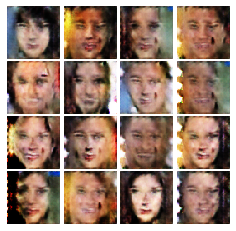


Iter: 16250, D: 0.1207, G:0.3627


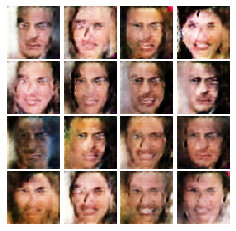


Iter: 16500, D: 0.1773, G:0.08734


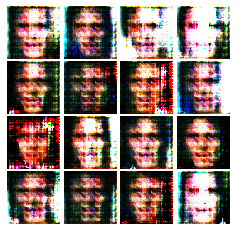


Iter: 16750, D: 0.1212, G:0.2254


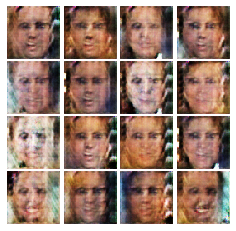


Saving the model as a checkpoint...
EPOCH:  18
Iter: 17000, D: 0.1026, G:0.2262


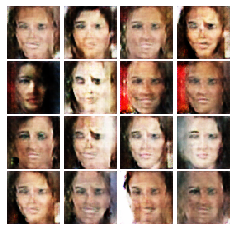


Iter: 17250, D: 0.1347, G:0.08473


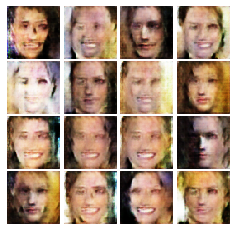


Iter: 17500, D: 0.1635, G:0.2583


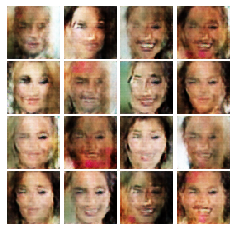


Saving the model as a checkpoint...
EPOCH:  19
Iter: 17750, D: 0.1415, G:0.08215


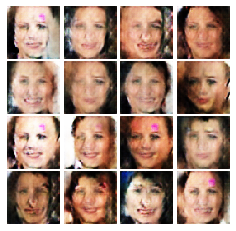


Iter: 18000, D: 0.1375, G:0.2041


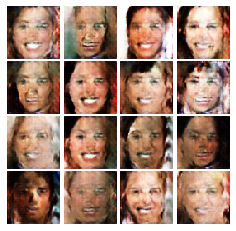


Iter: 18250, D: 0.401, G:0.04622


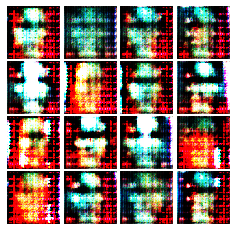


Iter: 18500, D: 0.1337, G:0.04778


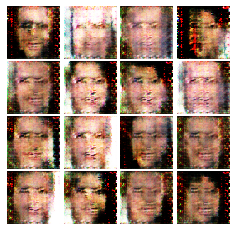


Saving the model as a checkpoint...
EPOCH:  20
Iter: 18750, D: 0.1197, G:0.1799


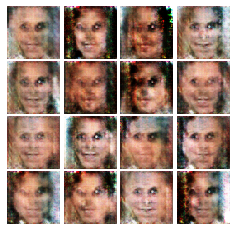


Iter: 19000, D: 0.3133, G:0.002262


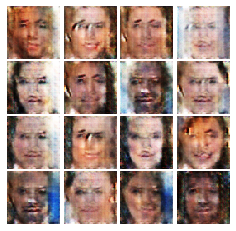


Iter: 19250, D: 0.1742, G:0.01049


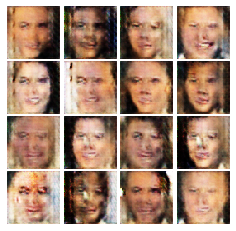


Iter: 19500, D: 0.162, G:0.04787


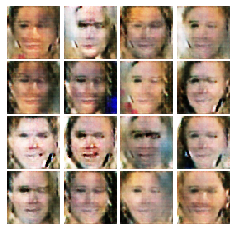


Saving the model as a checkpoint...
EPOCH:  21
Iter: 19750, D: 0.1387, G:0.08536


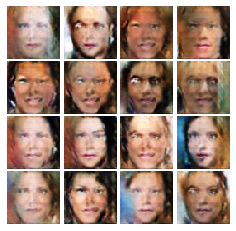


Iter: 20000, D: 0.1237, G:0.2451


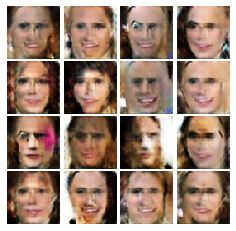


Iter: 20250, D: 0.1582, G:0.0584


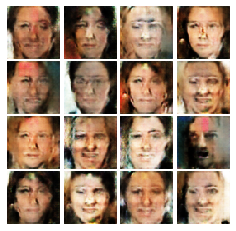


Iter: 20500, D: 0.1424, G:0.3028


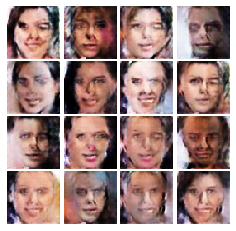


Saving the model as a checkpoint...
EPOCH:  22
Iter: 20750, D: 0.1286, G:0.1196


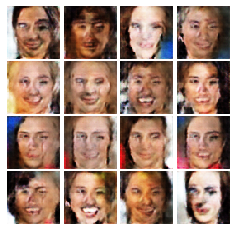


Iter: 21000, D: 0.1185, G:0.1791


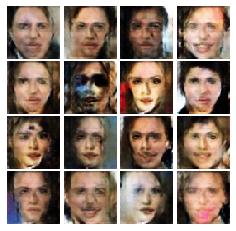


Iter: 21250, D: 0.1427, G:0.059


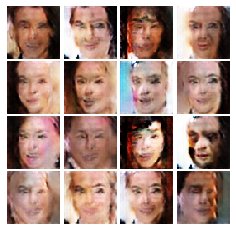


Iter: 21500, D: 0.1732, G:0.04029


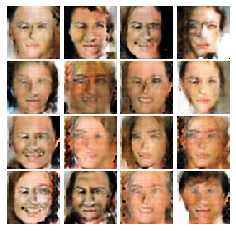


Saving the model as a checkpoint...
EPOCH:  23
Iter: 21750, D: 0.1413, G:0.1222


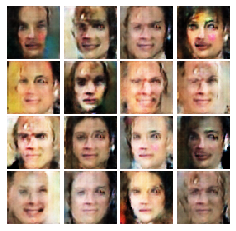


Iter: 22000, D: 0.1307, G:0.1704


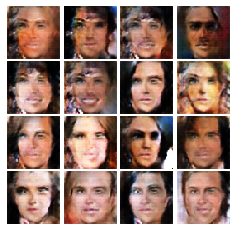


Iter: 22250, D: 3.976, G:0.8098


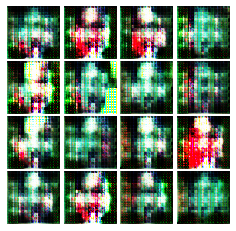


Iter: 22500, D: 0.2177, G:0.01132


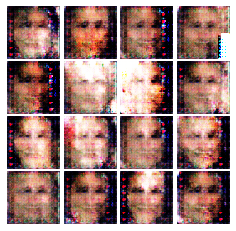


Saving the model as a checkpoint...
EPOCH:  24
Iter: 22750, D: 0.1725, G:0.0704


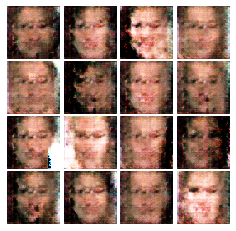


Iter: 23000, D: 0.1967, G:0.007782


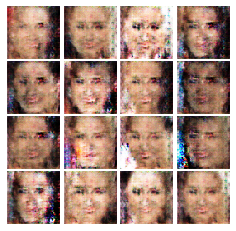


Iter: 23250, D: 0.1882, G:0.03174


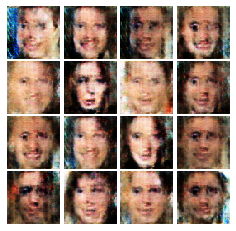


Iter: 23500, D: 0.187, G:0.01174


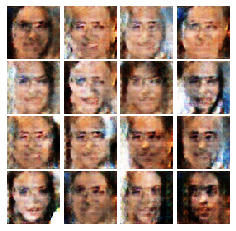


Saving the model as a checkpoint...
EPOCH:  25
Iter: 23750, D: 0.1487, G:0.05615


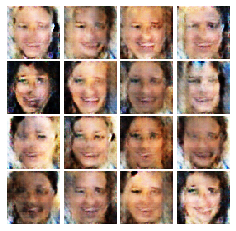


Iter: 24000, D: 0.2019, G:0.04046


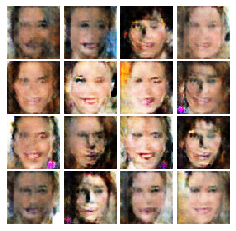


Iter: 24250, D: 0.1649, G:0.052


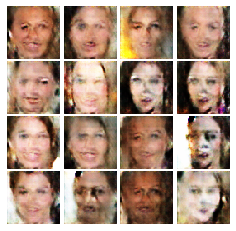


Iter: 24500, D: 0.1721, G:0.01377


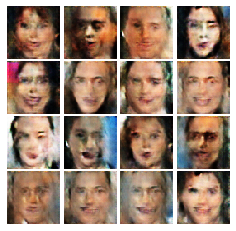


Saving the model as a checkpoint...
EPOCH:  26
Iter: 24750, D: 0.1688, G:0.03553


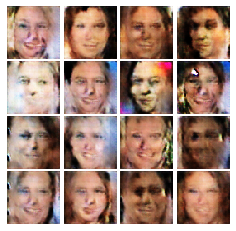


Iter: 25000, D: 0.1669, G:0.02748


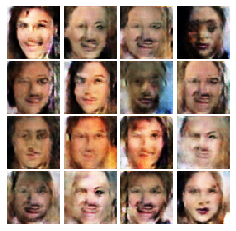


Iter: 25250, D: 0.1719, G:0.02789


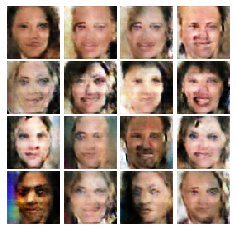


Iter: 25500, D: 0.1758, G:0.06767


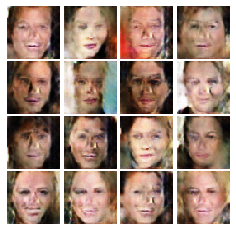


Saving the model as a checkpoint...
EPOCH:  27
Iter: 25750, D: 0.1555, G:0.07082


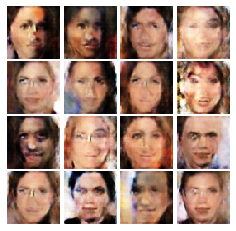


Iter: 26000, D: 0.1686, G:0.0518


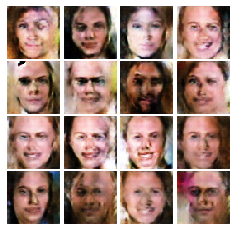


Iter: 26250, D: 13.38, G:4.0


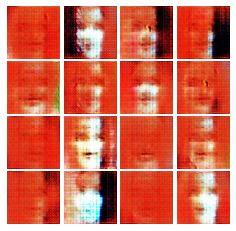


Iter: 26500, D: 0.1363, G:0.09064


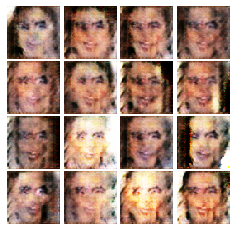


Saving the model as a checkpoint...
EPOCH:  28
Iter: 26750, D: 0.1494, G:0.04326


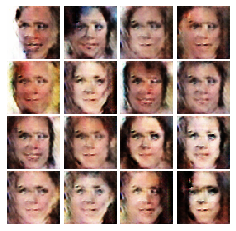


Iter: 27000, D: 0.177, G:0.06802


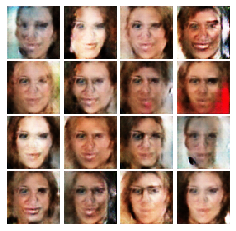


Iter: 27250, D: 0.153, G:0.04526


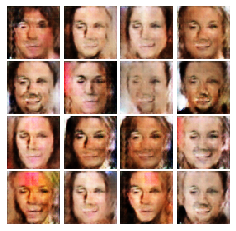


Iter: 27500, D: 0.144, G:0.1784


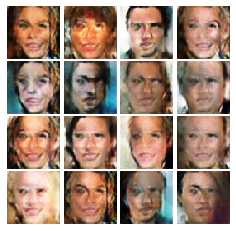


Saving the model as a checkpoint...
EPOCH:  29
Iter: 27750, D: 0.1341, G:0.06609


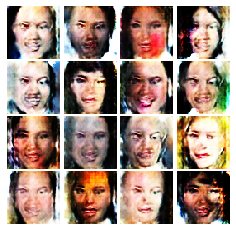


Iter: 28000, D: 0.1509, G:0.05662


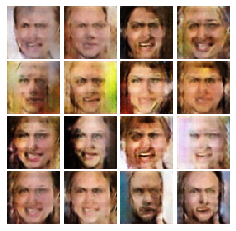


Iter: 28250, D: 0.1463, G:0.1714


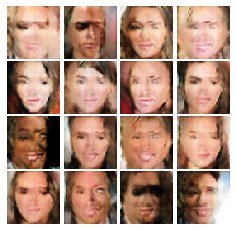


Iter: 28500, D: 0.153, G:0.0647


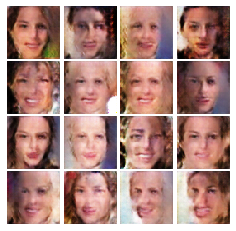


Saving the model as a checkpoint...
EPOCH:  30
Iter: 28750, D: 0.1456, G:0.08408


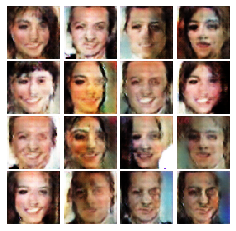


Iter: 29000, D: 0.1445, G:0.167


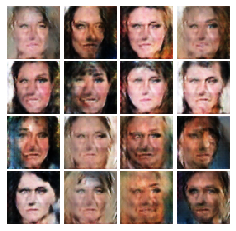


Iter: 29250, D: 0.08574, G:0.5888


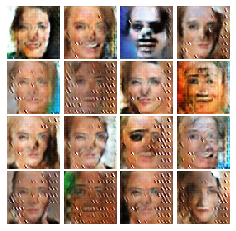


Iter: 29500, D: 0.1503, G:0.1599


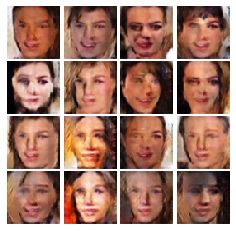


Saving the model as a checkpoint...


In [25]:
# LSGAN
# Add code here:
# original GAN
# Add code here:
netG = generator(NOISE_DIM).to(device)
netD = discriminator().to(device)

NOISE_DIM = 100
NUM_EPOCHS = 30
# learning_rate = 0.0002
learning_rate = 0.001


torch.autograd.set_detect_anomaly(True)

optimizerG = optim.Adam(netG.parameters(), lr=learning_rate,
                            betas=(0.5, 0.999))
optimizerD = optim.Adam(netD.parameters(), lr=learning_rate,
                            betas=(0.5, 0.999))

train(netD, netG, optimizerD, optimizerG, ls_discriminator_loss, ls_generator_loss, show_every=250, 
          ckpt_dir = path_to_homework + '/ckpts/Vanilla_gan_MINST/', cont_train=False,
          batch_size=128, noise_size=100, num_epochs=NUM_EPOCHS, train_loader=celeba_loader_train, device=device)

### Section 2.6 Conclusion? [10 pts]
You have successfully trained you GAN models. Hurray! Now, we want you to answer the following question in few sentences.
1. Have you observed any difference between GAN and LSGAN (e.g. training, generation quality)?

A: For the training, the loss of LSGAN is much smaller than that of GAN. Besides, the generated image quality are better from original GAN.

2. Did your GAN models generate you diverse faces? Or did it should give you similar stuff all the time?

A: It gives diverse outputs, the reason is that we have random noise as input.

3. How can you quantitatively evaluate your GAN model? Is the metric(s) meaningful? Is there any drawback about this metric(s)?

A: Commonly, we apply FID or human evaluation. However, the FID can only judge the generated results with same distribution to the ImageNet, because FID is pretrained on it. Moreover, FID is not useful to jugdge semantics but only on the reality. As for the human evaluation, it is time-consuming but effective.

### Guidelines for Downloading PDF in Google Colab
- Run below cells only in Google Colab, Comment out in case of Jupyter notebook

In [ ]:
#Run below two lines (in google colab), installation steps to get .pdf of the notebook

!apt-get install texlive texlive-xetex texlive-latex-extra pandoc
!pip install pypandoc

# After installation, comment above two lines and run again to remove installation comments from the notebook.

In [ ]:
# Find path to your notebook file in drive and enter in below line

!jupyter nbconvert --to PDF "your_notebook_path_here/DL_Assignment_5.ipynb"

#Example: "/content/drive/My Drive/DL_Fall_2020/Assignment_5/DL_Assignment_5.ipynb"